<a href="https://colab.research.google.com/github/AriadneKas/Image_Video_analysis/blob/main/Lab1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1. Θεωρητκό μέρος

#### α) Πώς η τιμή του α επηρεάζει την γκαουσιανή πυραμίδα;

Όταν η τιμή του α είναι 0.4 το σχήμα της συνάρτησης βάρους μοιάζει με αυτή της Γκαουσιανής. Όσο μικραίνει το α η συνάρτηση γίνεται όλο και πιο επίπεδη. Όταν το α παίρνει την τιμή 0.5 η συνάρτηση μετατρέπεται σε τριγωνική και οποιαδήποτε αύξηση πέραν απο το 0.5 αυξάνει απότομα την κορυφή του τριγώνου και δημιουργεί αρνητικούς λοβούς στα άκρα του τριγώνου.

<p style="margin:0">Αυτή η συμπεριφορά έχει ώς αποτέλεσμα όσο μικρότερο είναι το a τόσο περισσότερες ηψυλότερες συχνότητες περνάνε απο το φίλτρο με αποτέλσμα να έχουμε μια λεπτομερή εικόνα. Αντίθετα όταν το a μεγαλώνει οι ψηλές συχνότητες κόβονται και η εικόνα του επόμενου επιπέδου είναι πιο smooth.</p>

#### β) Τι ορίζουμε ως εντροπία; Υπολογίστε τη μέγιστη τιμή εντροπίας που μπορεί να έχει μια grayscale εικόνα;

Η εντροπία ορίζεται ως μια μετρική της τυχαιότητας των τιμών των πίξελ μιας εικόνας. Αν f(i) είναι η παρατηρούμενη συχνότητα εμφάνισης κάθε γκρί επιπέδου i τότε η εντροπία μπορεί να υπολογιστεί απο τον τύπο: $$H = -\sum_{i=0}^{255} f(i)\log_{2}f(i)$$ Όσο πιο ομοιόμορφη είναι η κατανομή της συχνότητας των επιπέδων τόσο μεγαλύτερη είναι η εντροπία. Επομένως η εντροπία θα έχει την τιμή $$H_{max} = \log_{2}256 = 8$$

#### γ) Πώς η επιλογή του μεγέθους του bin επηρεάζει το αποτέλεσμα του κβαντισμού;

Το μέγεθος του κάδου σε ένα δεδομένο επίπεδο πυραμίδας αντανακλά την ευαισθησία του ανθρώπινου παρατηρητή σε σφάλματα αντίθεσης εντός των χωρικών ζωνών συχνοτήτων που αντιπροσωπεύονται σε αυτό το επίπεδο.
Όσο μεγαλύτερο είναι το μέγεθος του bin τόσο περισσότερη πληροφορία χάνεται. Αντίθετα για μικρά bins αποθηκεύεται περισσότερη πληροφορία.

#### δ) Εξηγήστε πώς επηρεάζεται η κβάντιση από το πλήθος των επιπέδων της πυραμίδας;

Η κβάντιση χρησιμοποιείται για να ελατώσουμε το πλήθως των επιπέδων της λαπλασιανής πυραμίδας. Μεγαλύτερα επίπεδα κβάντισης οδηγούν σε περισσότερο λεπτομερείς εικόνες με αποτέλεσμα να χρειαζόμαστε περισσότερα επίπεδα. Αντίθετα μικρά επίπεδα κβάντισης συνεπάγονται λιγότερα λεπτομερείς εικόνες και επομένως χρειαζόμαστε λιγότερα επίπεδα πυραμίδας.

# 2. Εργαστηριακό μέρος

## Μέρος Α : Υλοποίηση αλγορίθμου

In [75]:
import urllib.request
import scipy
import skimage
import cv2
import numpy as np
from skimage import data
from scipy.signal import convolve2d
from matplotlib import pyplot as plt
%matplotlib inline

Φόρτωση των images Lena, Camera:

In [76]:
#Lena image
HTTP_response = urllib.request.urlopen('http://www.image.ntua.gr/~tpar/LABimage/lena.png')


In [77]:
arr = np.asarray(bytearray(HTTP_response.read()), dtype=np.uint8)
BGR = cv2.imdecode(arr,-1)

Text(0.5, 1.0, 'Lena, grayscale')

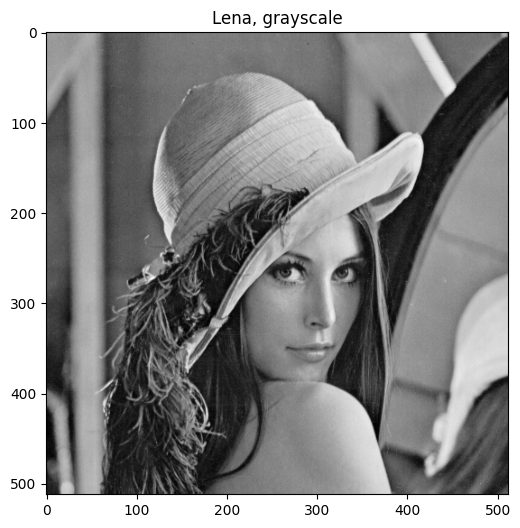

In [78]:
#convert to gray
Lena_gray = cv2.cvtColor(BGR, cv2.COLOR_BGR2YCrCb)[:,:,0]
plt.figure(figsize=(6, 6))
plt.imshow(Lena_gray, cmap="gray")
plt.title('Lena, grayscale')

Text(0.5, 1.0, 'Lena, RGB')

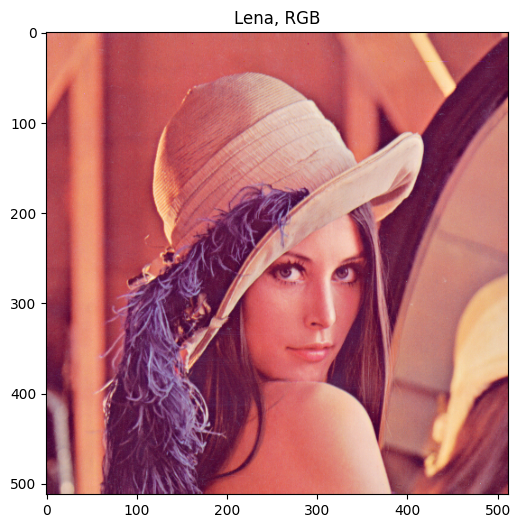

In [79]:
#keep with color, convert to RGB
Lena_RGB = cv2.cvtColor(BGR, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(6, 6))
plt.imshow(Lena_RGB)
plt.title('Lena, RGB')

Text(0.5, 1.0, 'Camera, grayscale')

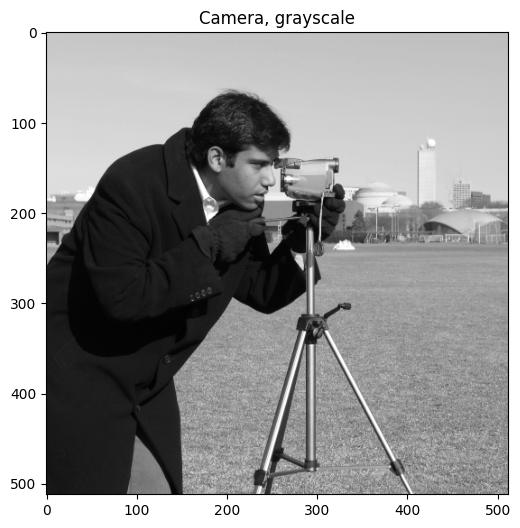

In [80]:
Camera=skimage.data.camera()
plt.figure(figsize=(6, 6))
plt.imshow(Camera, cmap="gray")
plt.title('Camera, grayscale')

Helper function

In [81]:
#function for printing a pyramid
def showPyramid(pyramid, case):
    if (case=='gray'):                                                                        #grayscale image
        f, ax = plt.subplots(1, len(pyramid), figsize=(20, 20))  
        for i in range (0,len(pyramid)):
            ax[i].imshow(pyramid[i], cmap="gray") # Base of the pyramid
            ax[i].set_title('Level {}'.format(i), fontsize=14)
    else:
        f, ax = plt.subplots(1, len(pyramid), figsize=(20, 20))                               #image with color
        for i in range (0,len(pyramid)):
            ax[i].imshow(pyramid[i].astype(int)) # Base of the pyramid
            ax[i].set_title('Level {}'.format(i), fontsize=14)

**Ερώτημα α):**

In [82]:
def GKernel(a):
  w = np.array([0.25 - a/2.0, 0.25, a, 0.25, 0.25 - a/2.0])                                   #1D kernel
  return w*w.reshape(-1,1)   

**Ερώτημα β):**

In [83]:
def GREDUCE(I,h):
  reduced_downsampled = None
  low_pass_image = cv2.filter2D(I,-1,h)                                                        #convolve image with generating kernel
  reduced_downsampled = low_pass_image[::2,::2]                                                #downsample lowpass image (sampling rate reduced in half)
  return reduced_downsampled

**Ερώτημα γ):** 

In [84]:
def GPyramid(I,a,depth):
  pyramid = [I]
  kernel = GKernel(0.4)
  for i in range(0,depth-1):
    gaussian_image = GREDUCE(pyramid[i],kernel)                                               #apply GREDUCE to image of previous level to get lowpass image of next level
    pyramid.append(gaussian_image)
  return pyramid

**Ερώτημα δ):**

In [85]:
def GEXPAND(I,h):
  expanded_image = None
  if (len(I.shape)==2):                                                                       #grayscale image
    tmp_image = np.zeros((I.shape[0]*2, I.shape[1]*2), dtype=np.float64)                      #obtain an array with every other pixel same as initial image, the rest of the pixels zero,
    tmp_image[::2,::2]=I                                                                      #will be used later for the interpolation of new node values between given values
  else:                                                                                       #image with color
    tmp_image = np.zeros((I.shape[0]*2, I.shape[1]*2, I.shape[2]), dtype=np.float64)
    tmp_image[::2,::2,:]=I
    expanded_image=np.zeros((I.shape[0]*2, I.shape[1]*2, I.shape[2]), dtype=np.float64)
  expanded_image = 4*cv2.filter2D(tmp_image,-1,h)                                             #equation (2) of paper
  return expanded_image

**Ερώτημα ε):**

In [86]:
def LPyramid(I,a,depth):
  gaussian_pyramid = GPyramid(I,a,depth)
  laplacian_pyramid = []
  kernel = GKernel(a)                                                                       #obtain generating kernel for the given value of a
  for i in range(0,depth-1):
    gaussian_image = gaussian_pyramid[i]
    expanded_gaussian_image = GEXPAND(gaussian_pyramid[i+1],kernel)                         #EXPAND image of each level to get the same dimensions as the previous level
    laplacian_pyramid.append(gaussian_image - expanded_gaussian_image+128)                  #get difference of images, add 128 so that we obtain only positive values (center around 128, not zero, this will be substracted 
                                                                                            #during deconstruction so it does not affect results, needed for prinintg the image)
  laplacian_pyramid.append(gaussian_pyramid[depth-1])
  return laplacian_pyramid

**Ερώτημα στ):**

In [87]:
def L_Pyramid_Decode(L,a):
    kernel = GKernel(a)
    sum_image=L[len(L)-1]
    for i in range(len(L)-2, -1, -1):
        expanded_image = GEXPAND(sum_image,kernel)                                          #expand image to obtain dimensions same as the previous level
        sum_image=L[i]+expanded_image-128                                                   #sum previous level to the sum image calculated so far
    return sum_image 

**Ερώτημα ζ):**

In [88]:
def L_Quantization(L,bins):                                                                 #Input parameters: the image to be quantized and the number of bins
    if (len(L.shape)==2):                                                                   #grayscale image
        C=np.zeros((L.shape[0], L.shape[1]), dtype=np.float64)
        max_val=L.max()
        n=256/bins                                                                          #maximum value is 255 (so 256 integer values: 0...255), calculate bin size for n bins
        for i in range (0,L.shape[0]):                                                      #for each pixel
            for j in range(0,L.shape[1]):
                for m in range(0,bins):
                    if (L[i][j]<=(m+1/2)*n and L[i][j]>=(m-1/2)*n):                         #equation (5) of paper
                        C[i][j]=m*n
    else:                                                                                   #image with color
        C=np.zeros((L.shape[0], L.shape[1],L.shape[2]), dtype=np.float64)
        max_val=L.max()
        n=255/bins                                                                          #maximum value is 255, calculate bin size for n bins
        for i in range (0,L.shape[0]):                                                      #for each pixel
            for j in range(0,L.shape[1]):
                for k in range(0,L.shape[2]):
                    for m in range(0,bins):
                        if (L[i][j][k]<=(m+1/2)*n and L[i][j][k]>=(m-1/2)*n):               #equation (5) of paper
                            C[i][j][k]=m*n
    return C

## Μέρος Β : Δοκιμές αλγορίθμου

Παρουσιάζουμε τις Gaussian πυραμίδες που πρκύπτουν, για τις εικόνες Lena (grayscale, RGB), και Camera:

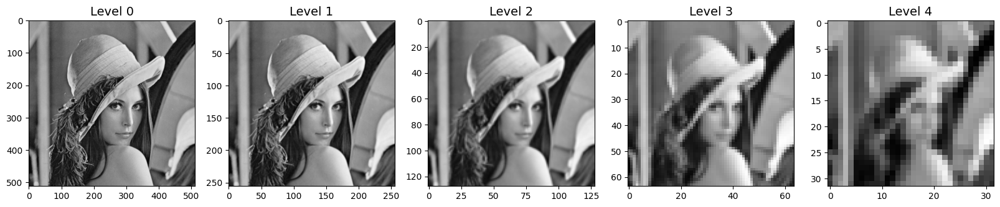

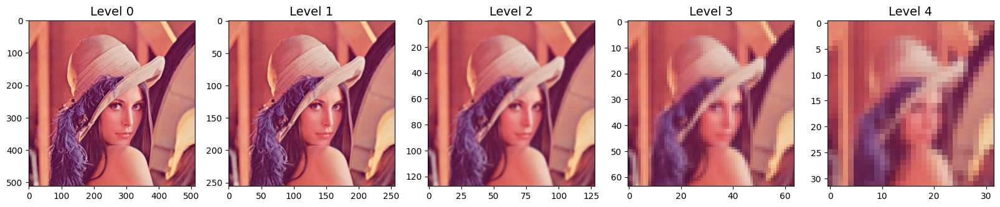

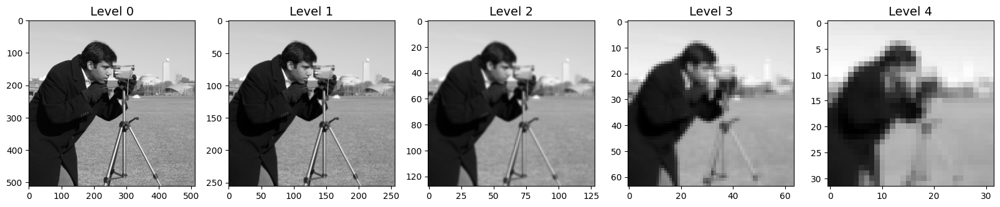

In [89]:
#calculate and print gaussian pyramid for each image 

#Lena grayscale
Lena_gray_gaus=GPyramid(Lena_gray,0.4,5)
#print(len(Lena_gray_gaus))
showPyramid(Lena_gray_gaus,'gray')

#Lena RGB
Lena_RGB_gaus=GPyramid(Lena_RGB,0.4,5)
showPyramid(Lena_RGB_gaus,'gray')

#Camera
Camera_gaus=GPyramid(Camera,0.4,5)
showPyramid(Camera_gaus,'gray')

Κάθε επίπεδο αποτελεί ένα βαθυπερατό τμήμα του προηγούμενου επιπέδου. Όσο προχωράμε σε επόμενα επίπεδα η εικόνα γίνεται πιο θολή (λιγότερο crisp).

**Ερώτημα α):**

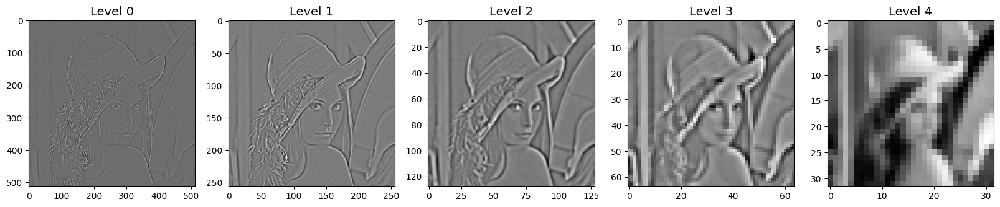

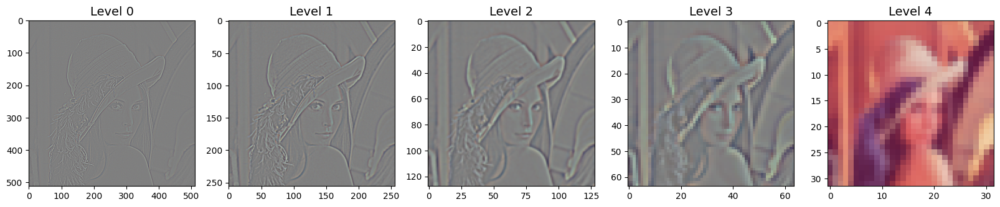

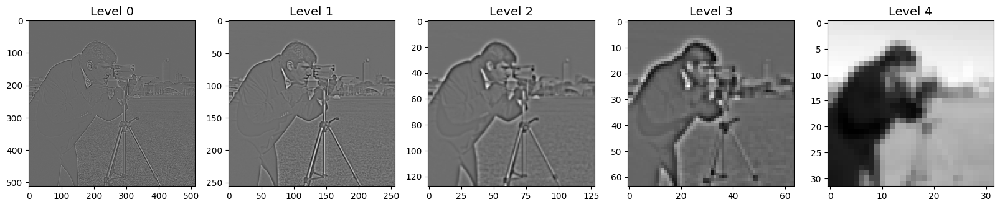

In [90]:
#Laplacian Pyramid

#Lena grayscale
Lena_gray_lap=LPyramid(Lena_gray,3/8,5)
showPyramid(Lena_gray_lap, 'gray')

#Lena RGB
Lena_RGB_lap=LPyramid(Lena_RGB,3/8,5)
showPyramid(Lena_RGB_lap,'RGB')

#Camera
Camera_lap=LPyramid(Camera,3/8,5)
showPyramid(Camera_lap,'gray')

Παρατηρούμε ότι στις εικόνες της Laplacian πυραμίδας εμφανίζονται έντονα οι λεπτομέρειες της εικόνας όπως για παράδειγμα οι ακμές αυτής. Οι πιο fine λεπτομέρειες είναι ορατές σε χαμηλότερα επίπεδα, ενώ όσο προχωράμε σε επόμενα επίπεδα βλέπουμε πιο coarse χαρακτηρηστικά. Αυτό συμβαίνει αφού ουσιαστικά κάθε επίπεδο προκύπτει ως η λεπτομέρεια μιας εικόνας με όλο και πιο βαθυπερατό φάσμα στην Gaussian πυραμίδα.

Στην συνέχεια παρουσιάζουμε την ανακατασευασμένη από την Laplacian πυραμίδα εικόνα, καθώς και την αρχική εικόνα

Text(0.5, 1.0, 'Original')

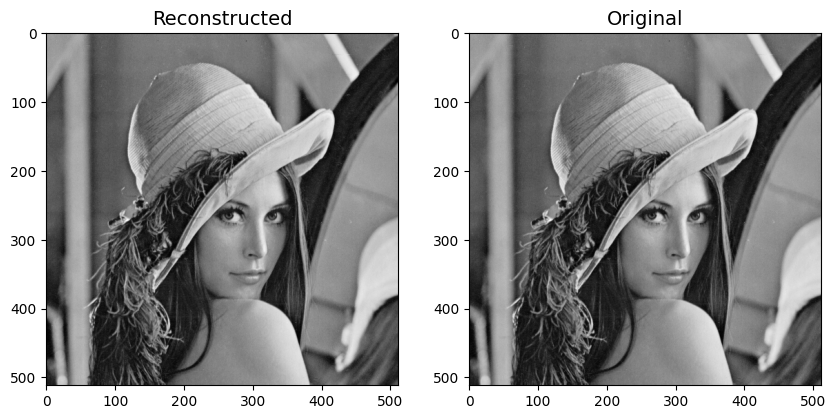

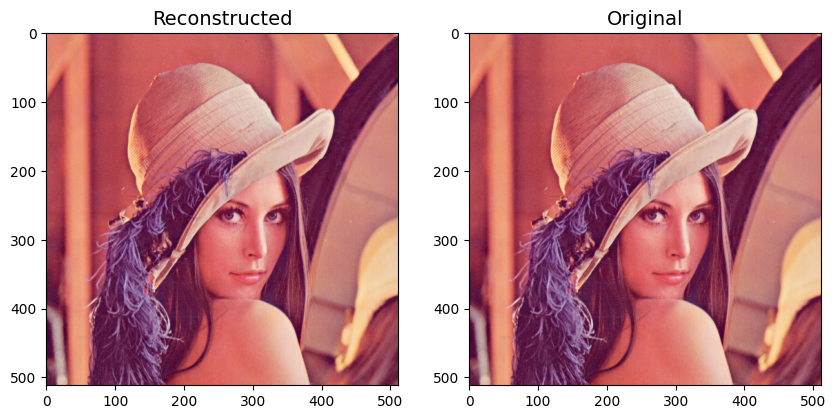

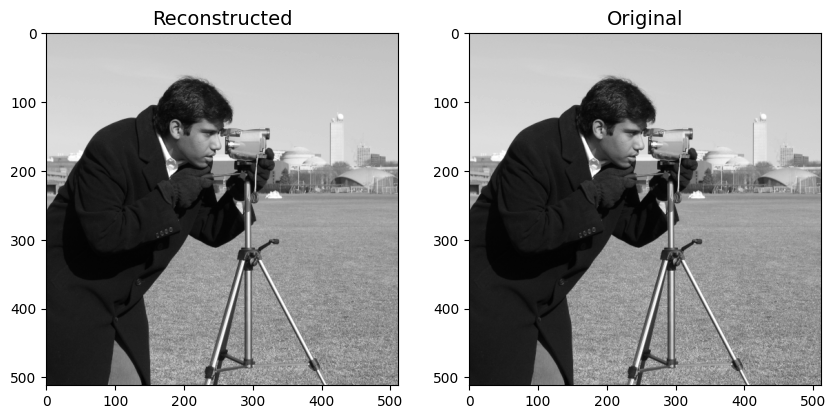

In [91]:
#Plot reconstructed images 

#Lena grayscale
Lena_gray_dec=L_Pyramid_Decode(Lena_gray_lap,3/8)
f1, (ax0,ax1)= plt.subplots(1, 2, figsize=(10, 10))

ax0.imshow(Lena_gray_dec, cmap="gray")
ax0.set_title('Reconstructed', fontsize=14)
ax1.imshow(Lena_gray, cmap="gray")
ax1.set_title('Original', fontsize=14)

#Lena RGB
Lena_RGB_dec=L_Pyramid_Decode(Lena_RGB_lap,3/8)
f2, (ax0,ax1)= plt.subplots(1, 2, figsize=(10, 10))
ax0.imshow(Lena_RGB_dec.astype(int), cmap="gray")
ax0.set_title('Reconstructed', fontsize=14)
ax1.imshow(Lena_RGB, cmap="gray")
ax1.set_title('Original', fontsize=14)

#Camera
Camera_dec=L_Pyramid_Decode(Camera_lap,3/8)
f3, (ax0,ax1)= plt.subplots(1, 2, figsize=(10, 10))
ax0.imshow(Camera_dec, cmap="gray")
ax0.set_title('Reconstructed', fontsize=14)
ax1.imshow(Camera, cmap="gray")
ax1.set_title('Original', fontsize=14)

In [92]:
# Check if the reconstruction is lossless

print('Is reconstruction exact for Lena grayscale?', (Lena_gray==Lena_gray_dec).all())
print('Is reconstruction exact for Lena RGB?',(Lena_RGB==Lena_RGB_dec).all())
print('Is reconstruction exact for Camera?',(Camera==Camera_dec).all())

Is reconstruction exact for Lena grayscale? True
Is reconstruction exact for Lena RGB? True
Is reconstruction exact for Camera? True


Παρατηρούμε ότι η ανακατασκευή της εικόνας από την Laplacian πυραμίδα γίνεται χωρίς απώλειες, κάτι το οποίο είναι αναμενόμενο σύμφωνα με την θεωρητική ανάλυση. (Προϋπόθεση αποτελεί ότι χρησισμοποιούμε κατά την κωδικοποίηση και κατά την αποκωδικοποίηση την ίδια τιμή για την παράμετρο a, στην παρούσα περίπτωση ίση με 3/8, ώστε να έχουμε το ίδιο generating kernel).

**Ερώτημα β):**

Εμφανίζουμε την Λαπλασιανή πυραμίδα για μεταβλητό a στο διάστημα [0.3,...0.7]. Χρησιμοποιήσαμε τιμές του αναφερθέντος διαστήματος με step 0.1 και να παρουσιάσουμε πυραμίδες πέντε επιπέδων (depth=4). Εμφανίζουμε επίσης την αρχική εικόνα, χάριν σύγκρισης.

In [93]:
#a function to show the pyramid for different values of a 
def showLaplacianForValuesOfa(I_original):                                          
    for a in range (3,8):
        a=a/10
        pyramid=LPyramid(I_original,a,4)                                            #compute the laplacian pyramid for specific a
        if (len(I_original.shape)==2):                                              #if the image is grayscale
            f, ax = plt.subplots(1, len(pyramid)+1, figsize=(20, 20))               #plot the pyramids
            for i in range (0,len(pyramid)):
                ax[i].imshow(pyramid[i], cmap="gray") 
                ax[i].set_title('Level {} '.format(i)+'(a ='+str(a)+')', fontsize=14)
            ax[i+1].imshow(I_original,cmap="gray")
            ax[i+1].set_title('Original image')
        else:                                                                        #else if the image is RGB
            f, ax = plt.subplots(1, len(pyramid)+1, figsize=(20, 20))                #plot the pyramids
            for i in range (0,len(pyramid)):
                ax[i].imshow(pyramid[i].astype(int)) 
                ax[i].set_title('Level {} '.format(i)+'(a ='+str(a)+')', fontsize=14)
            ax[i+1].imshow(I_original)
            ax[i+1].set_title('Original image')

Lena grayscale:

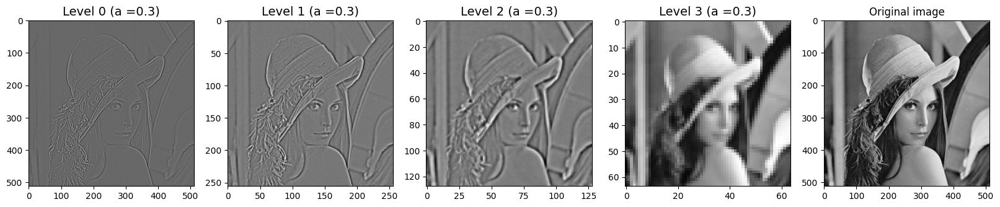

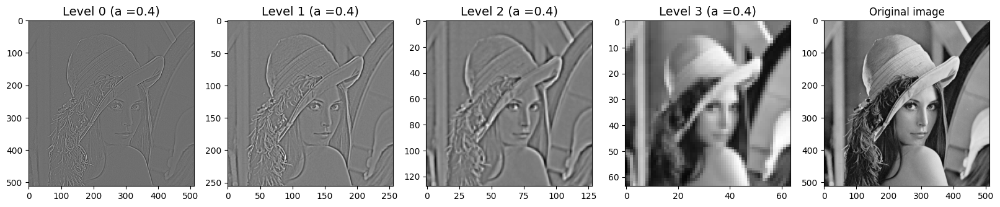

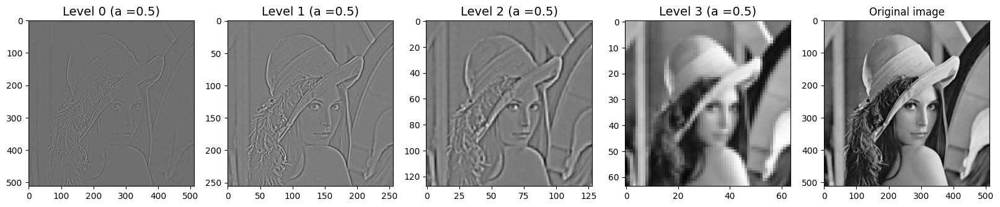

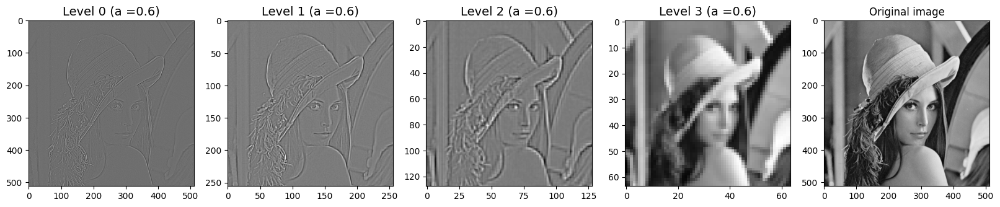

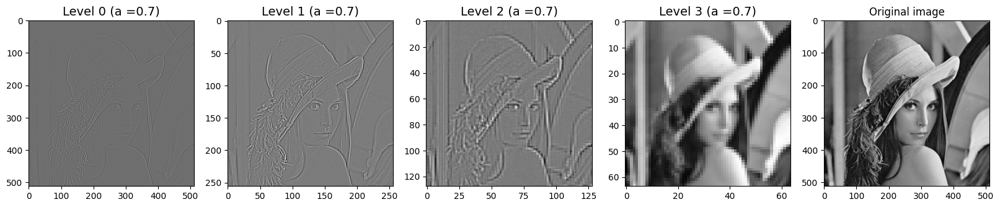

In [94]:
Lena_gray_decoded=showLaplacianForValuesOfa(Lena_gray)

Lena RGB:

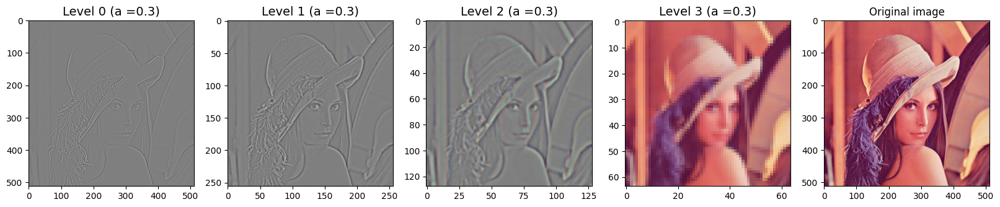

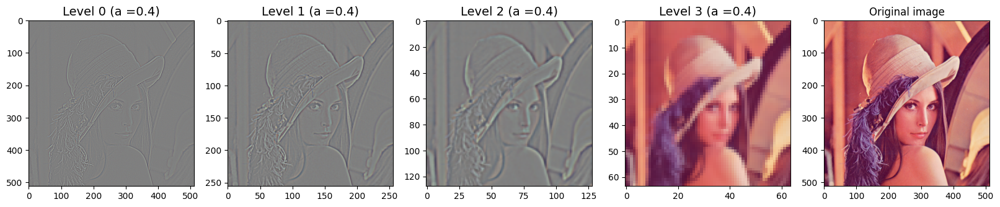

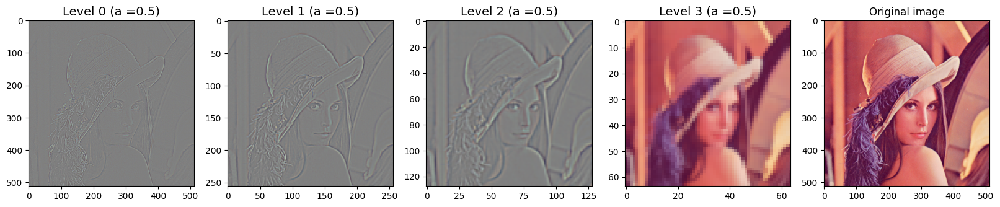

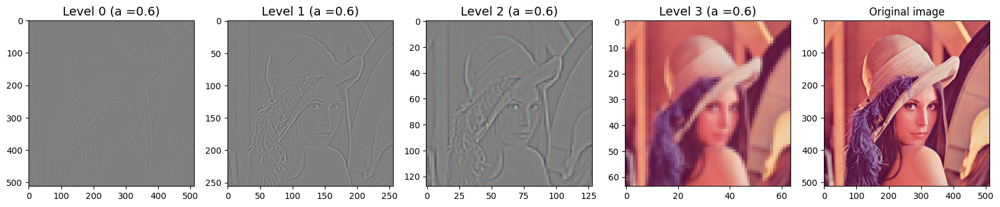

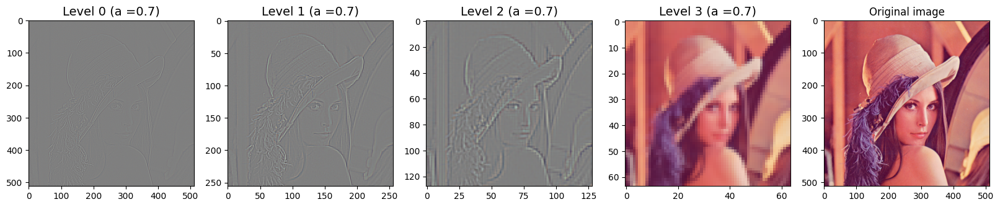

In [95]:
Lena_RGB_decoded=showLaplacianForValuesOfa(Lena_RGB)

Camera:

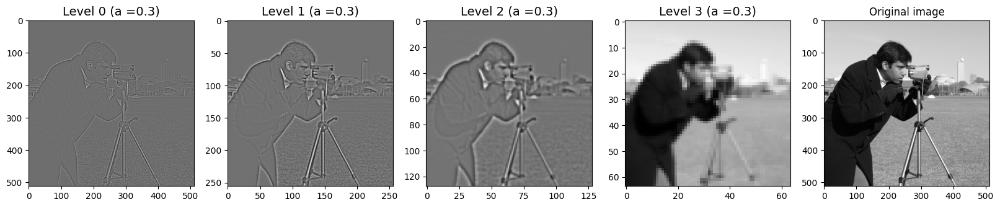

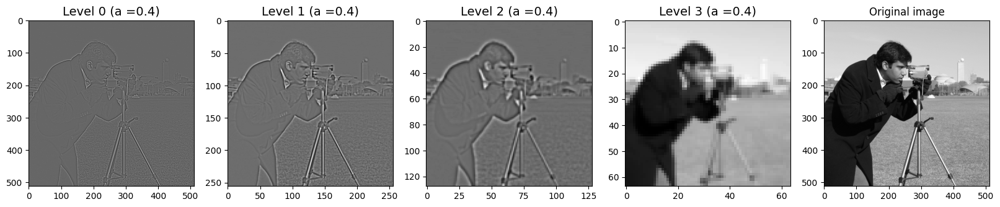

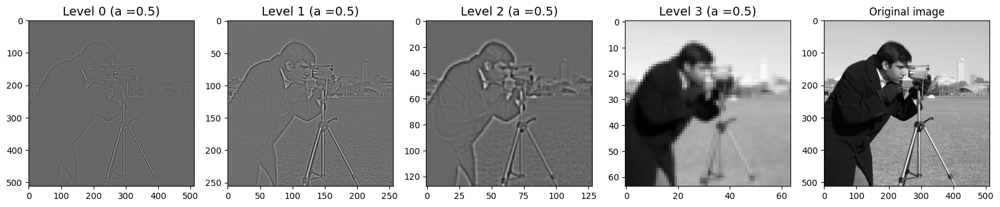

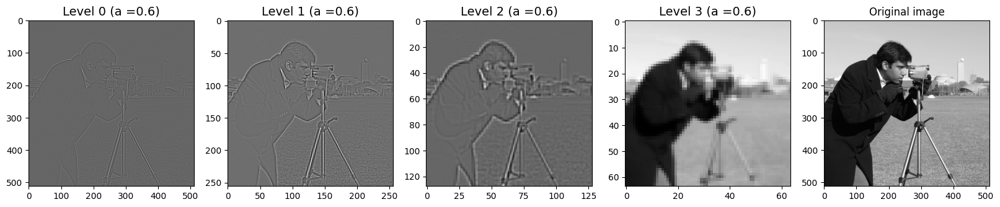

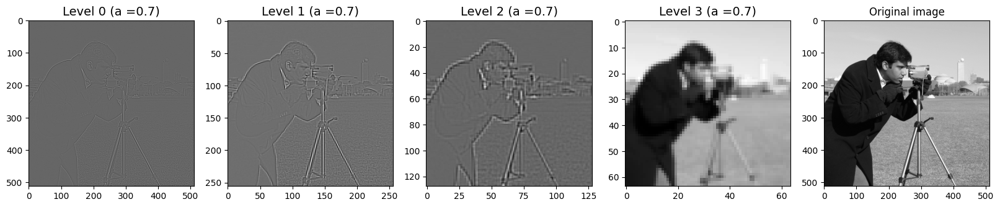

In [96]:
Camera_decoded=showLaplacianForValuesOfa(Camera)

Παρατηρούμε ότι αύξηση του α υποβαθμίζει οπτικά την ποιότητα των εικόνων της πυραμίδας. Συγκεκριμένα, παρατηρούμε πως οι μεταβάσεις μεταξύ των χρωμάτων γίνονται πιο απότομες όσο αυξάνεται η τιμή της παραμέτρου α. Κάτι τέτοιο μπορεί να εξηγηθεί αν αναλογιστούμε πως η τιμή της παραμέτρου α επηρεάζει την μορφή του generating kernel που χρησιμοποιούμε, με μεγαλύτερες τιμές της παραμέτρου να οδηγούν σε μεγαλύτερη συμμετοχή των κεντρικών pixel σε σχέση με τα ακριανά κατά τον υπολογισμό του σταθμισμένου μέσου όρου ανά pixel, στην διαδικασία του γκαουσιανού φιλτραρίσματος και άρα τελικά οι μεταβάσεις γίνονται λιγότερο ομαλές. Περισσότερο αντιληπτή αυτή η υποβάθμιση της ποιότητας γίνεται στο επίπεδο 3 (4ο επίπεδο) της κάθε πυραμίδας. Σημειώνουμε όμως πως αν και η παράμετρος α επηρεάζει το οπτικό αποτέλεσμα, η ανακατασκευή της εικόνας από την Laplacian πυραμίδα παραμένει τελείως ανεξάρτηση της επιλογής της παραμέτρου α.

Στην συνέχεια παρουσιάζουμε, για διαφορετικές τιμές της παραμέτρου α τα αθροίσματα εικόνας που προκύπτουν κατά την αποκωδικοποίηση:

In [97]:
#Τροποποίηση της L_Pyramid_Decode, ώστε να τυπώνει ταυτόχρονα τα αθροίσματα εικόνας που υπολογίζει:
def L_Pyramid_Show_Decode_Levels(L,a):                                                      #input parameters: Laplacian pyramid, a
    f, ax = plt.subplots(1, len(L), figsize=(20, 20))  
    kernel = GKernel(a)
    sum_image=L[len(L)-1]
    if (len(sum_image.shape)==2):                                                           #grayscale image
      ax[0].imshow(L[len(L)-1].astype(int),cmap='gray')                                     #show lowpass image (top level of pyramid)
    else:
      ax[0].imshow(L[len(L)-1].astype(int))                                                 #color image                                  
    ax[0].set_title('Level {} '.format(len(L)-1)+'(a ='+str(a)+')', fontsize=14)
    tmp=0
    for i in range(len(L)-2, -1, -1):
        tmp=tmp+1
        expanded_image = GEXPAND(sum_image,kernel)                                          #expand image to obtain dimensions same as the previous level
        sum_image=L[i]+expanded_image-128                                                   #sum previous level to the sum image calculated so far
        if (len(sum_image.shape)==2):
          ax[tmp].imshow(sum_image.astype(int),cmap='gray')                                 #show sum image
        else:
          ax[tmp].imshow(sum_image.astype(int)) 
        ax[tmp].set_title('Level {} '.format(i)+'(a ='+str(a)+')', fontsize=14)             
    return sum_image              

In [98]:
#call L_Pyramid_Show_Decode_Levels for different values of a
def showDecoded(I_original):                                                                #input parameter: original image
    for a in range (2,8):
        a=a/10
        pyramid=LPyramid(I_original,a,5)
        L_Pyramid_Show_Decode_Levels(pyramid,a)

Lena grayscale:

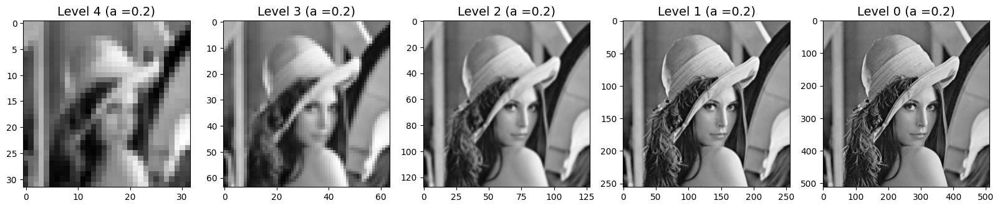

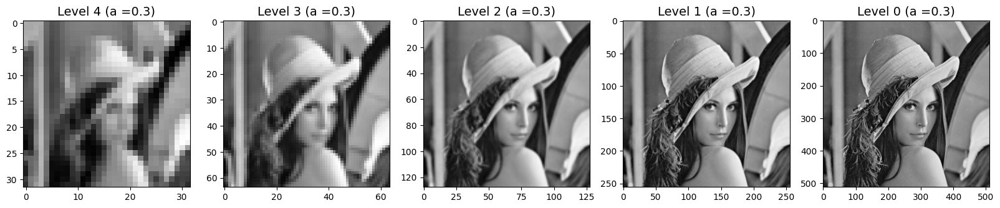

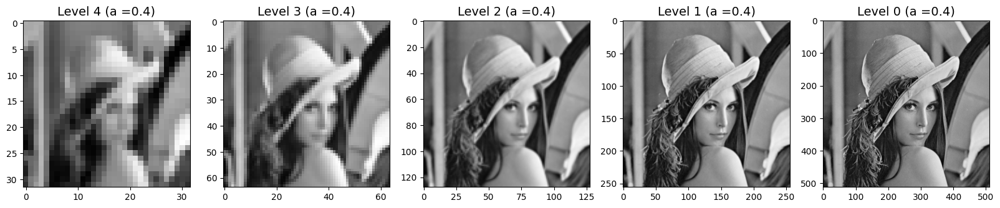

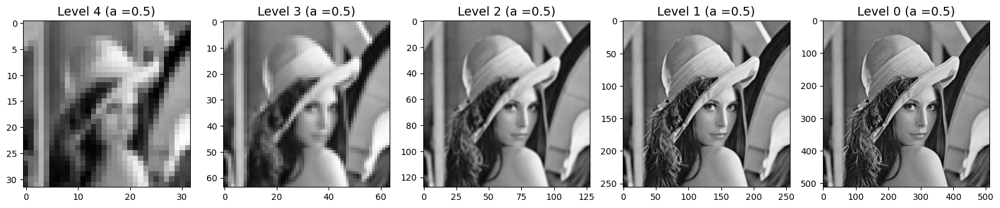

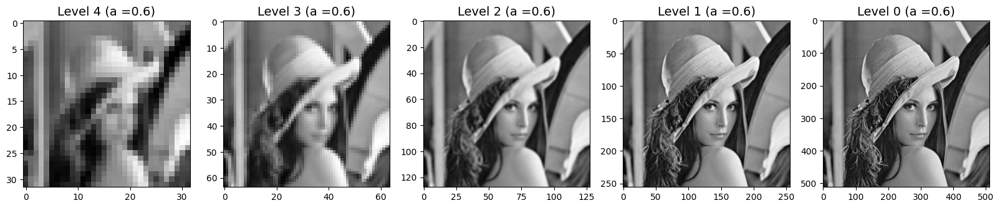

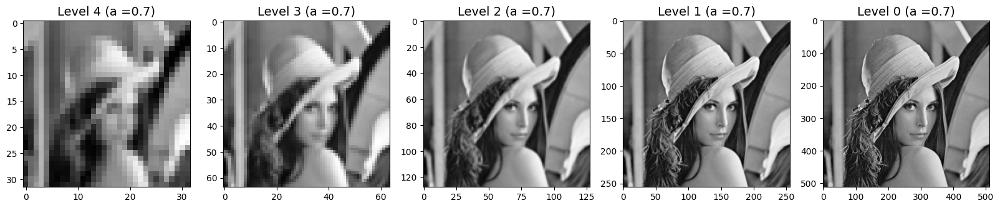

In [99]:
showDecoded(Lena_gray)

Lena RGB:

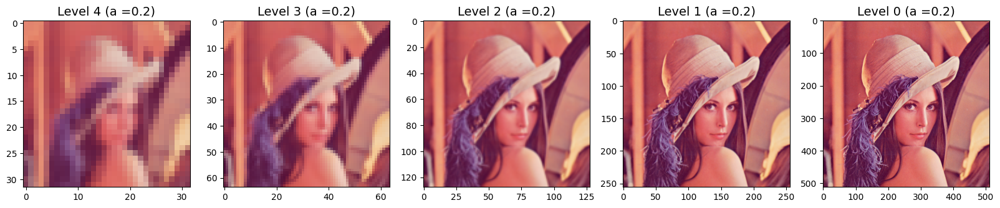

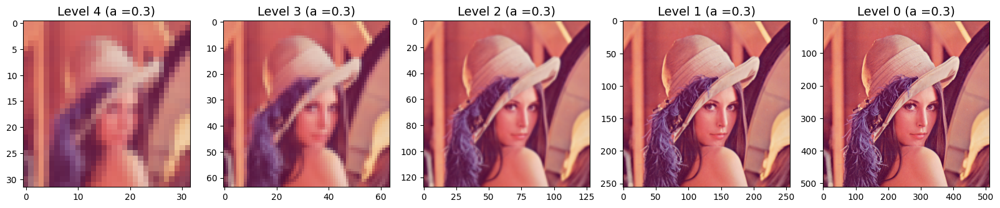

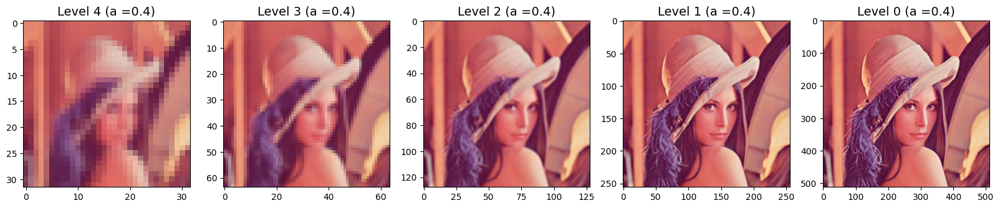

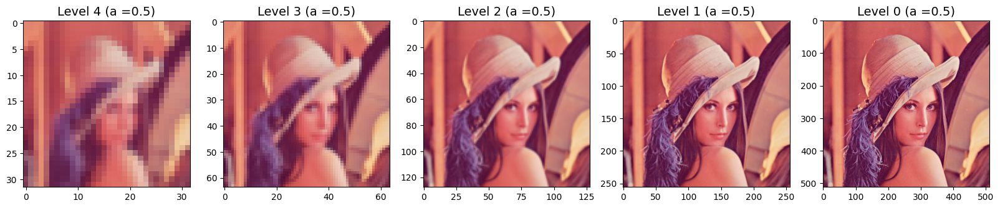

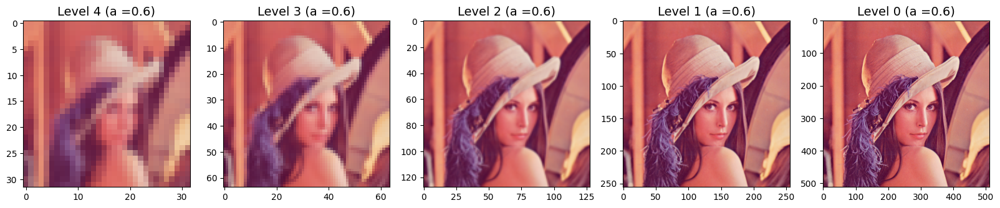

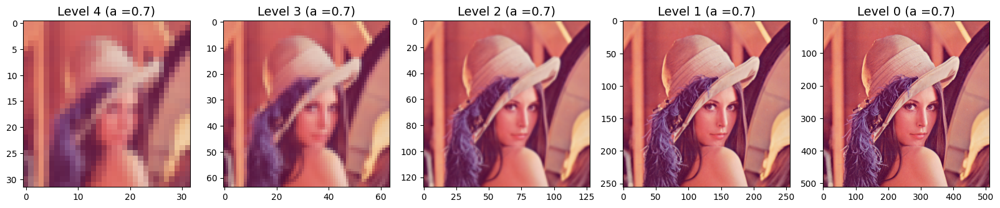

In [100]:
showDecoded(Lena_RGB)

Camera:

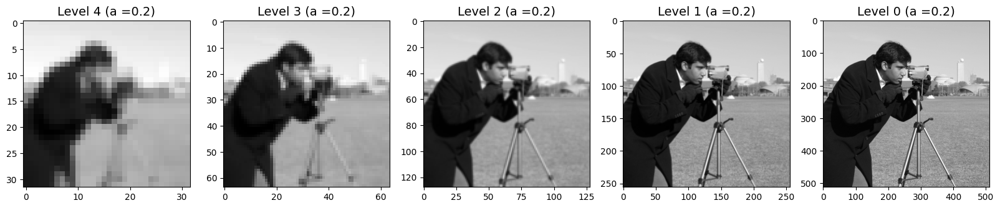

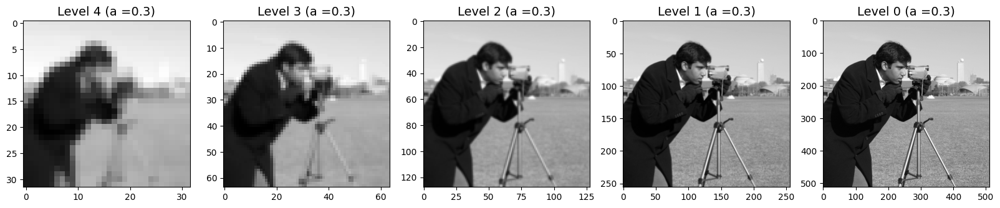

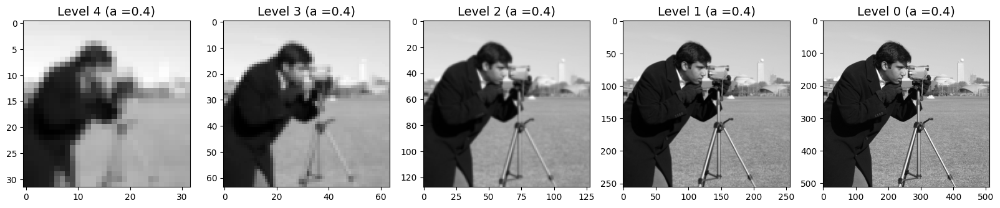

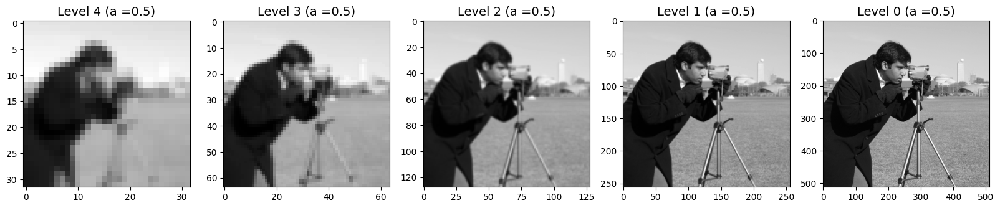

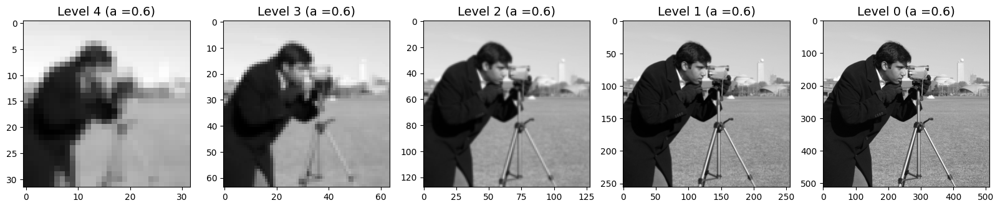

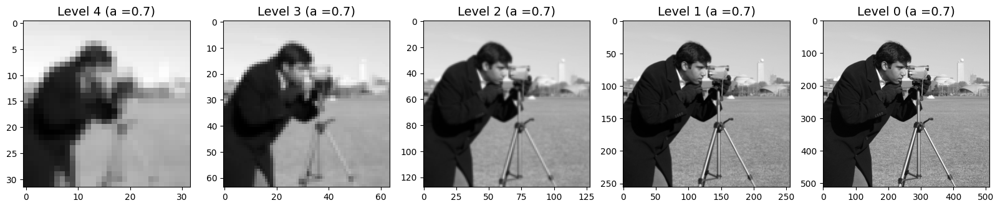

In [101]:
showDecoded(Camera)

Σημειώνουμε ότι, το Level 0 που εμφανίζουμε είναι σε κάθε περίπτωση το τελευταίο επίπεδο ανακατασκευής, δηλαδή η αρχική εικόνα. Με βάση τα παραπάνω μπορούμε να παρατηρήσουμε ότι:

Ξεκινώντας από την κορυφή της Laplacian πυραμίδας, δηλαδή από το πιο βαθυπερατό κομμάτι της εικόνας (ταυτίζεται με την κορυφή της Gaussian πυραμίδας), προσθέτουμε σε κάθε στάδιο την εικόνα λεπτομέρειας του επόμενου (χαμηλότερου) επιπέδου της Λαπλασιανής πυραμίδας. Από την θολή βαθυπερατή εικόνα προκύπτει σε κάθε στάδιο μια εικόνα με όλο και περισσότερη λεπτομέρεια, με τις πιο coarse λεπτομέρειες να εμφανίζονται πρώτα και τα πιο λεπτά χαρακτηρηστικά να γίνονται εμφανή στην συνέχεια. Αυτό έχει σαν αποτέλεσμα τελικά σε κάθε άθροισμα να προκύπτει μία όλο και πιο crisp εικόνα, μέχρι να φτάσουμε στην ανακατασκευασμένη εικόνα η οποία ταυτίζεται με την αρχική.

Όσον αφορά την επίδραση της μεταβολής του α, μπορούμε να παρατηρήσουμε πως αυτή δεν επιδρά στο οπτικό αποτέλεσμα των εικόνων αθροισμάτων αλλά ούτε και στην ποιότητα της ανακατασεκυασμένης εικόνας (έχουμε ακριβή ανακατασκευή).

**Ερώτημα γ):**

Εμφανίζουμε τώρα την Λαπλασιανή πυραμίδα για μεταβλητό depth (πλήθος επιπέδων) στο διάστημα [3,...,6]. Χρησιμοποιούμε τιμές στο προαναφερθέν διάστημα με step 1 και θέτουμε a=3/8. Εμφανίζουμε επίσης την αρχική εικόνας.

In [102]:
#a function to show the pyramid for different values of depth
def showLaplacianForDepths(I_original):    
    for d in range (3,6):
        pyramid=LPyramid(I_original,3/8,d)                                          #compute the pyramid for a specific depth
        if (len(I_original.shape)==2):                                              #if the image is grayscale
            f, ax = plt.subplots(1, len(pyramid)+1, figsize=(20, 20))  
            for i in range (0,len(pyramid)):                                        #plot the pyramids
                ax[i].imshow(pyramid[i], cmap="gray")                               # Base of the pyramid
                ax[i].set_title('Level {} '.format(i)+'(d ='+str(d)+')', fontsize=14)
            ax[i+1].imshow(I_original,cmap="gray")
            ax[i+1].set_title('Original image')
        else:                                                                       #if the image is RGB
            f, ax = plt.subplots(1, len(pyramid)+1, figsize=(20, 20))  
            for i in range (0,len(pyramid)):                                        #plot the pyramids
                ax[i].imshow(pyramid[i].astype(int))                                # Base of the pyramid
                ax[i].set_title('Level {} '.format(i)+'(d ='+str(d)+')', fontsize=14)
            ax[i+1].imshow(I_original)
            ax[i+1].set_title('Original image')

 Lena grayscale:

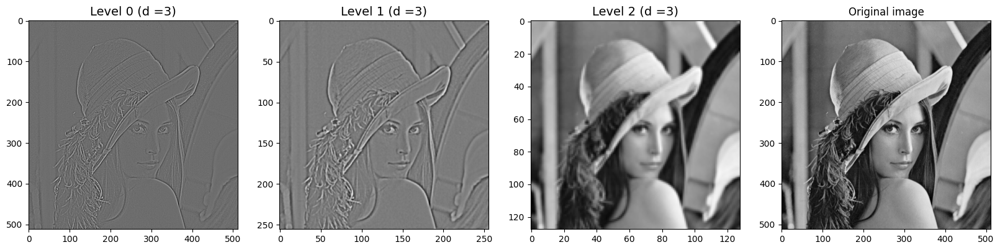

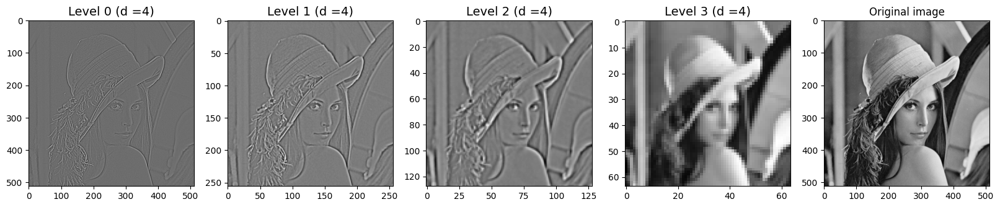

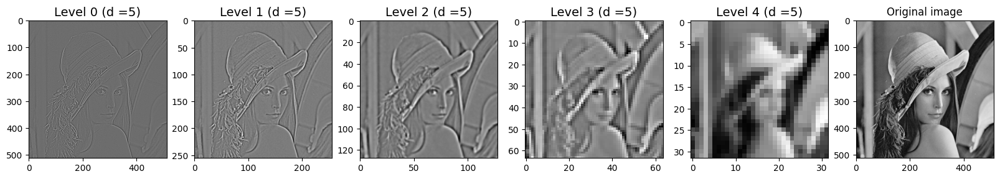

In [103]:
Lena_gray_decoded=showLaplacianForDepths(Lena_gray)

Lena RGB:

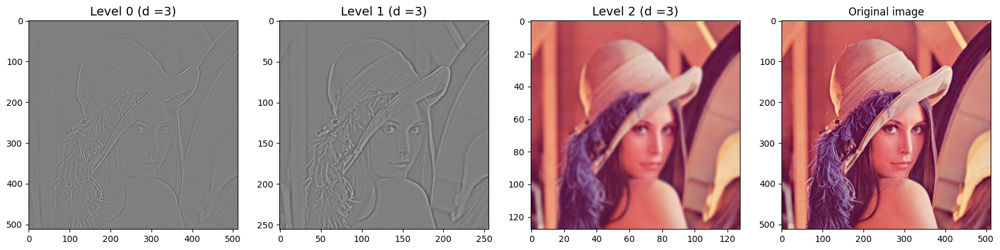

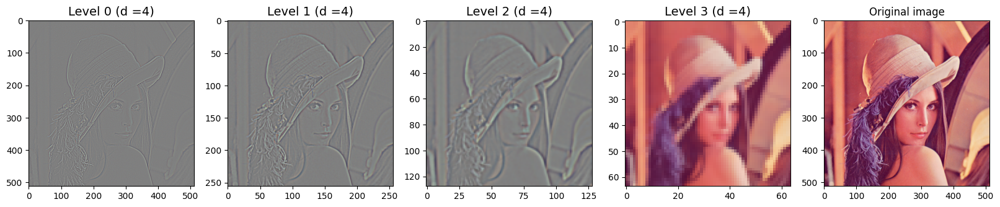

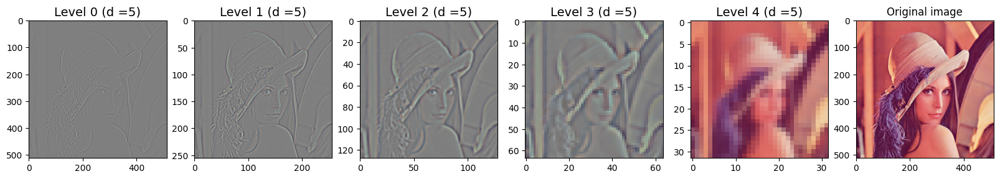

In [104]:
Lena_RGB_decoded=showLaplacianForDepths(Lena_RGB)

 Camera:

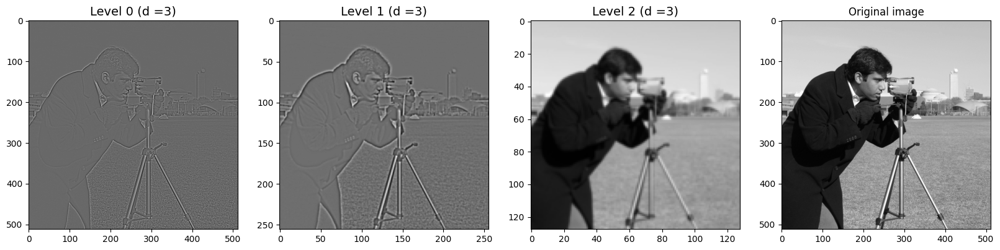

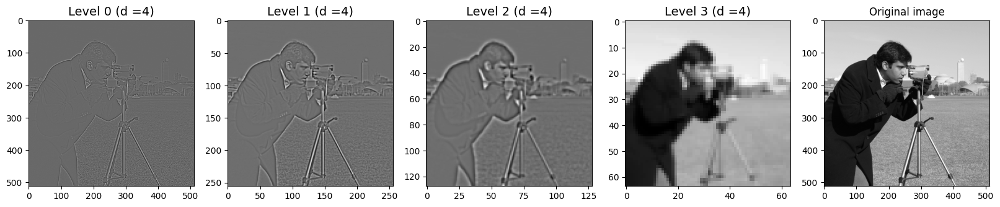

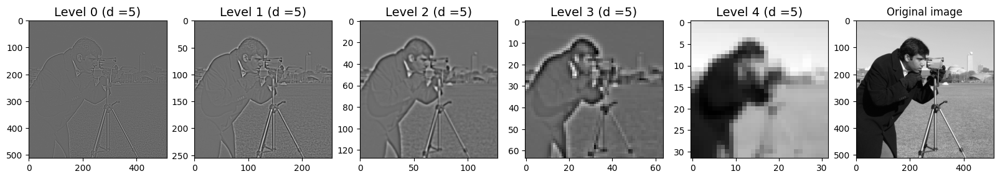

In [105]:
Camera_decoded=showLaplacianForDepths(Camera)

Βλέπουμε πως με την αύξηση του αριθμού των επιπέδων, στο τελικό επίπεδο η εικόνα έχει χειρότερο οπτικό αποτέλεσμα:

Για μικρότερο αριθμό επιπέδων η κορυφή της πυραμίδας κωδικοποιεί περισσότερη πληροφορία με μεγαλύτερη μέγιστη συχνότητα από την κορυφή μίας πυραμίδας περισσότερων επιπέδων άρα έχει, εκτός από μεγαλύτερες διαστάσεις, περισσότερη λεπτομέρεια. Αντίθετα, όσο αυξάνουμε τον αριθμό επιπέδων, έχουμε χωρισμό της εικόνας μας σε όλο και περισσότερα ζωνοπερατά τμήματα-επίπεδα λεπτομέρειας.

Στην συνέχεια παρουσιάζουμε τα αθροίσματα εικόνας που προκύπτουν κατά την αποκωδικοποίηση, σύμφωνα με την διαδικασία που περιγράφηκε στο θεωρητικό μέρος, δηλαδή κατά την άθροιση κάθε φορά την Λαπλασιανής εικόνας με το μέχρι τώρα άθροισμα εικόνας, αφού διπλασιάσουμε τις διαστάσεις αυτού:

In [106]:
#Τροποποίηση της L_Pyramid_Decode, ώστε να τυπώνει ταυτόχρονα τα αθροίσματα εικόνας που υπολογίζει:
def L_Pyramid_Show_Decode_Levels_forDepths(L,a,depth):                                       #input parameters: Laplacian pyramid, a, pyramid depth
    f, ax = plt.subplots(1, len(L), figsize=(20, 20))  
    kernel = GKernel(a)
    sum_image=L[len(L)-1]
    if(len( sum_image.shape)==2):
      ax[0].imshow(L[len(L)-1].astype(int),cmap='gray') # top of the pyramid                 #show lowpass image (top level of pyramid)
    else:
      ax[0].imshow(L[len(L)-1].astype(int)) # top of the pyramid
    ax[0].set_title('Level {} '.format(len(L)-1)+'(d ='+str(depth)+')', fontsize=14)
    tmp=0
    for i in range(len(L)-2, -1, -1):
        tmp=tmp+1
        expanded_image = GEXPAND(sum_image,kernel)                                          #expand image to obtain dimensions same as the previous level
        sum_image=L[i]+expanded_image-128                                                   #sum previous level to the sum image calculated so far, substract 128, added earlier
        if(len(sum_image.shape)==2):                                                        #grayscale image
          ax[tmp].imshow(sum_image.astype(int),cmap='gray')                                 #show sum image
        else:                                                                               #color image
          ax[tmp].imshow(sum_image.astype(int),cmap='gray')
        ax[tmp].set_title('Level {} '.format(i)+'(d ='+str(depth)+')', fontsize=14)             
    return sum_image  

In [107]:
def showDecodedForDepths(I_original):
    for d in range (2,8):
        pyramid=LPyramid(I_original,3/8,d)
        L_Pyramid_Show_Decode_Levels_forDepths(pyramid,3/8,d)

Lena grayscale:

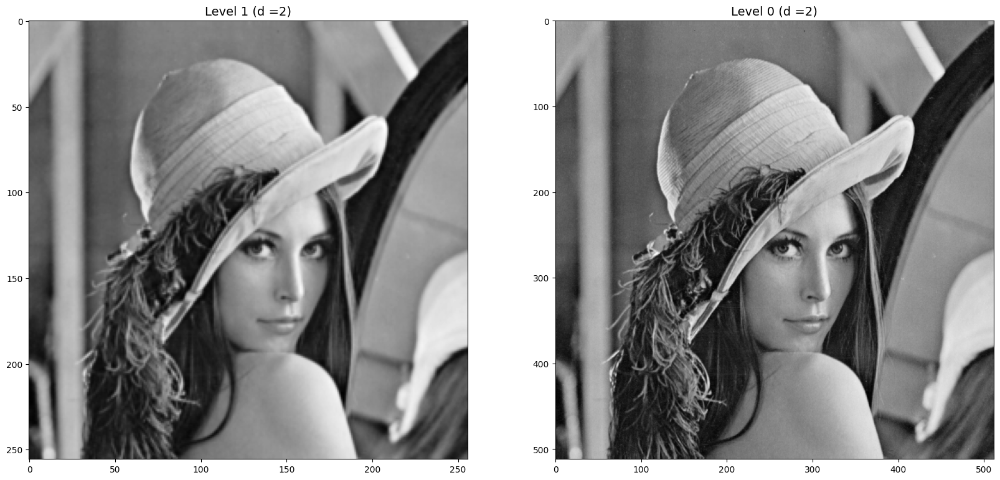

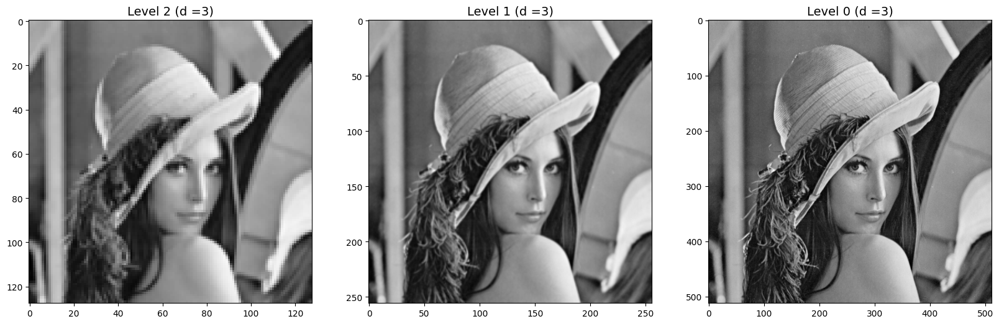

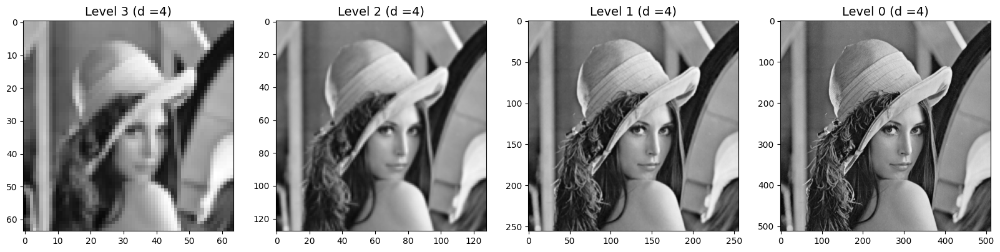

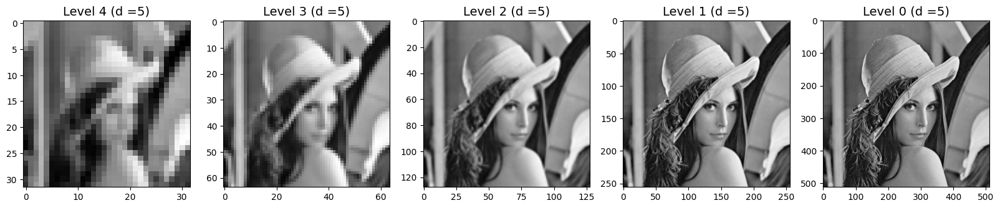

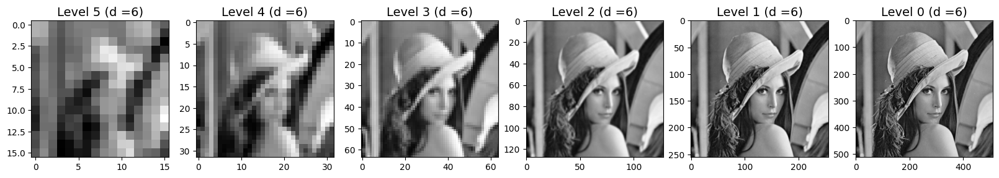

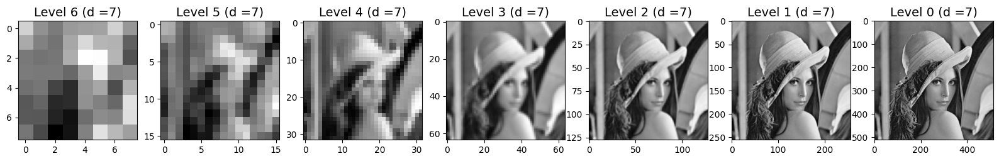

In [108]:
showDecodedForDepths(Lena_gray)

 Lena RGB:

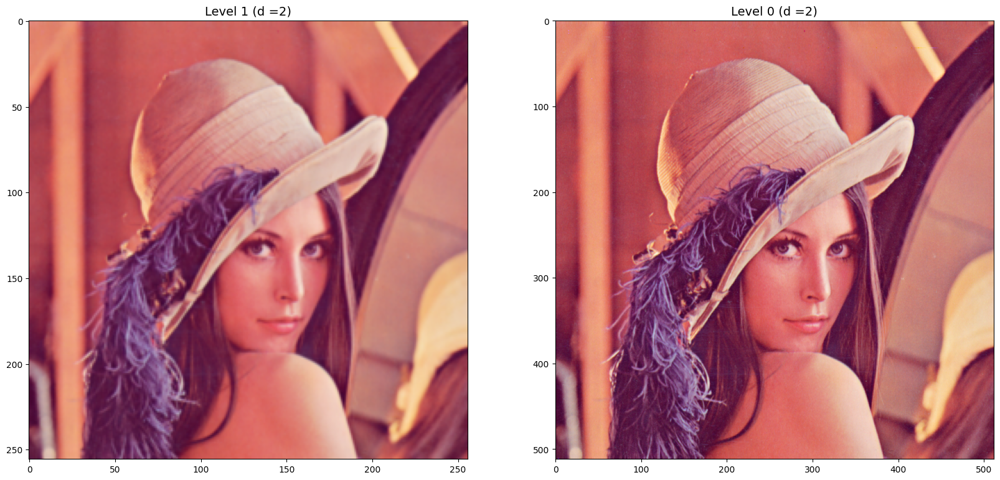

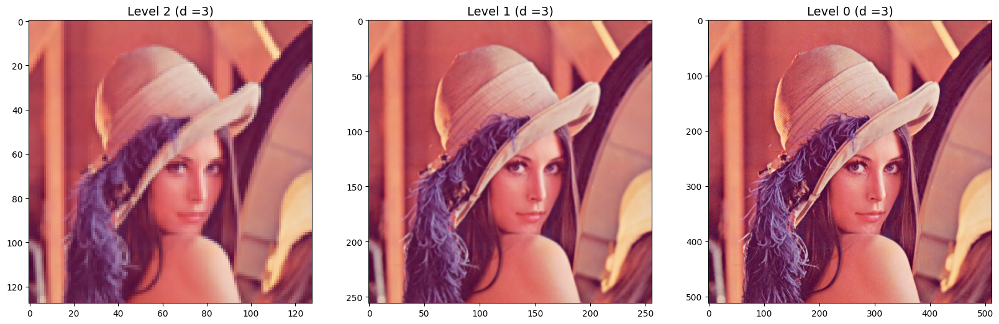

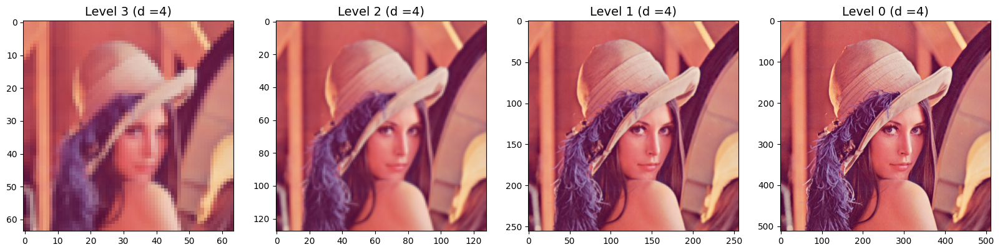

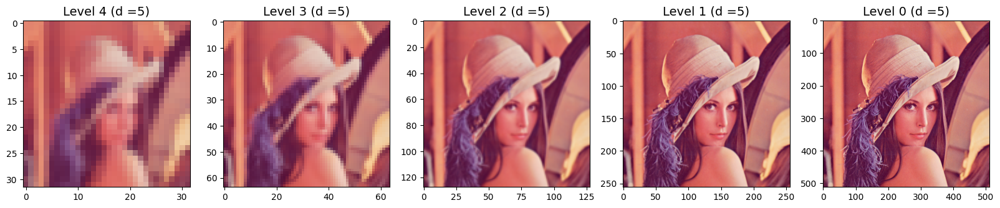

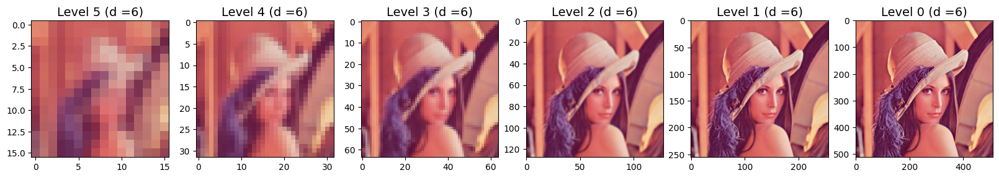

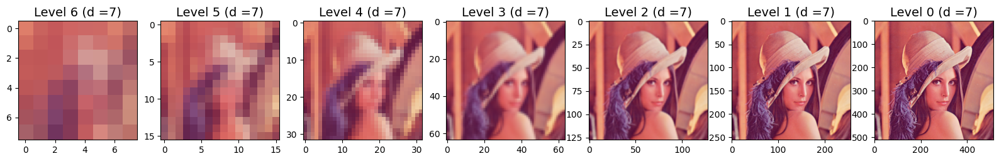

In [109]:
showDecodedForDepths(Lena_RGB)

Camera:

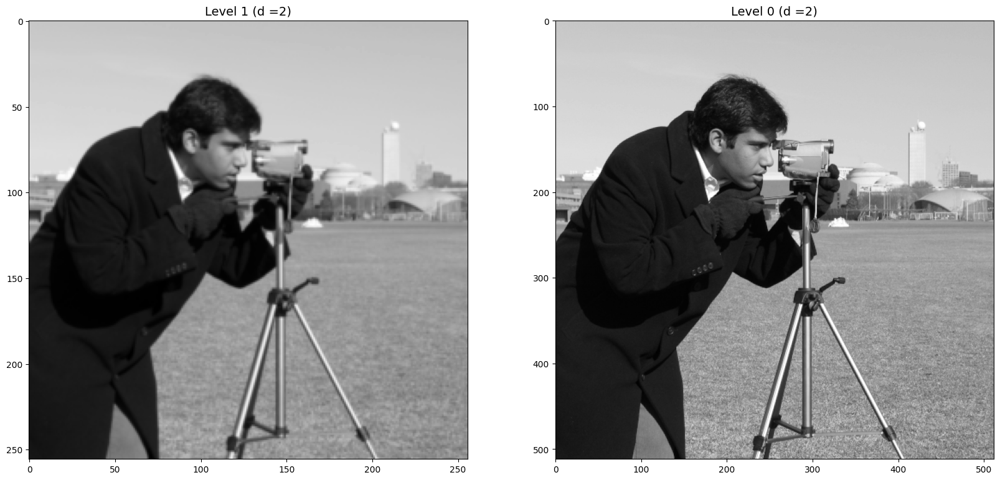

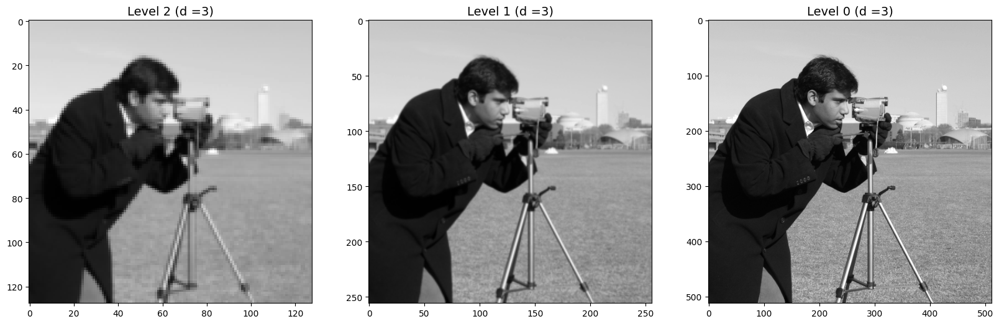

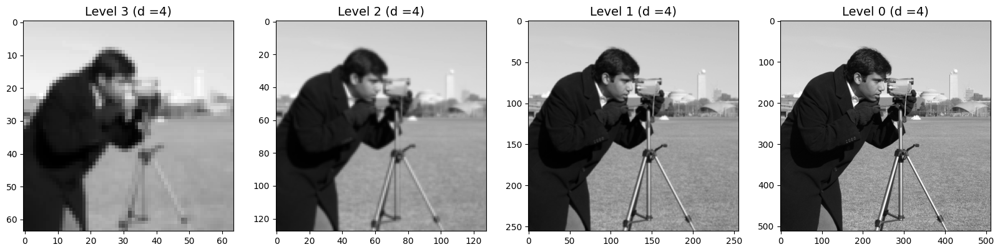

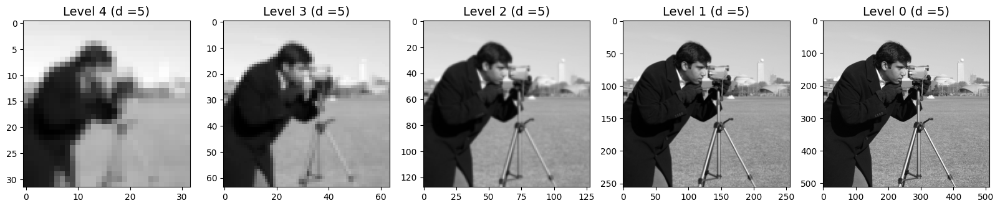

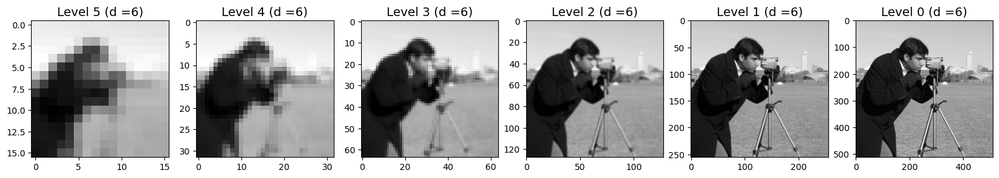

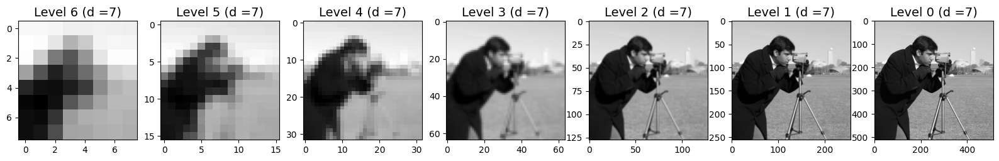

In [110]:
showDecodedForDepths(Camera)

Από τα παραπάνω μπορούμε να παρατηρήσουμε πως ο αριθμός επιπέδων που θα επιλέξουμε για την πυραμίδα μας δεν επηρεάζει το τελικό αποτέλεσμα της αποκωδικοποιημένης εικόνας, η οποία είναι τέλεια ανακατασκευή της αρχικής. Αυτό που αλλάζει είναι το φάσμα (άρα το πόσο υψηλές συχνότητες- λεπτομέρειες περιέχει) της κορυφής της Λαπλασιανής πυραμίδας, καθώς όσο περισσότερα επίπεδα έχουμε τόσο περισσότερα βαθυπερατά φιλτραρίσματα έχουν προηγηθεί.

Οσο περισσότερα επίπεδα έχουμε, σε τόσο περισσοτερα ζωνοπερατά τμήματα είναι χωρισμένη η εικόνα μας (η λεπτομέρεια της αρχικής εικόνας) και έτσι για περισσότερα επίπεδα η κορυφή της πυραμίδας μας είναι πολύ θολή και η λεπτομέρεια προστίθεται σταδιακά κατά την διαδικασία ανακατασκευής.

**Ερώτημα δ):**

In [111]:
import scipy.stats as st

In [112]:
#A function to compute histogram for a specific pyramid and depth
def computeSumHist(LaplacianPyramid,depth):  
    sum_hist = np.zeros([256,1], np.float64)
    for n in range(depth-1):
        hist = cv2.calcHist(np.float32([LaplacianPyramid[n]]), [0], None, [256], [0, 256])       #calculate the histogram for every level and add it to an array
        sum_hist += hist
    return sum_hist

#A function to compute pyramid and histogram for a specific a and depth
def calcHist (Image,a,depth):  
    LaplacianPyramid=LPyramid(Image,a,depth)                                                     #compute the pyramid
    sum_hist = computeSumHist(LaplacianPyramid,depth)                                            #compute the histogram
    return sum_hist

#A function to show histograms with variable a in range [0.2,0.7]
def ShowHistogramsFora (Image,depth):  
    final_sum_hist=[]                                                                            #an array that keeps the histograms for each a
    entropy=[]
    variance=[]
    for i in range (2,8):
        i=i/10
        helper=calcHist(Image,i,depth)                                                           #calculate histogram
        a=np.max(helper)                                                                         #compute max value of the histogram
        final_sum_hist.append(helper)           
        entropy.append(st.entropy(helper/a)[0])                                                  #calculate entropy of normalised histogram
        variance.append(np.var(helper/a))                                                        #calculate variance of normalised histogram
    f, ax = plt.subplots(2, 3, figsize=(20, 10) ) 
    c=0.1
    for i in range (1,7):
        c += 0.1
        plt.subplot(2,3,i)
        plt.plot(final_sum_hist[i-1])                                                            #plot every histogram
        plt.title("Entropy = "+str(entropy[i-1])+" (a="+str(round(c,1))+")", fontsize=14) 
    return entropy,variance

#A function to show histograms with variable depth in range [2,7]        
def ShowHistogramsFordepth (Image,a):  
    final_sum_hist=[]                                                                            #an array that keeps the histograms for each depth
    entropy=[]
    for i in range (2,8):
        helper=calcHist(Image,a,i)                                                               #calculate histogram
        b=np.max(helper)                                                                         #compute max value of the histogram
        final_sum_hist.append(helper)
        entropy.append(st.entropy(helper/b)[0])                                                  #calculate entropy of normalised histogram
    f, ax = plt.subplots(2, 3, figsize=(20, 10) ) 
    c=1
    for i in range (1,7):
        c += 1
        plt.subplot(2,3,i)
        plt.plot(final_sum_hist[i-1])                                                            #plot every histogram
        plt.title("Entropy = "+str(entropy[i-1])+" (depth="+str(c)+")", fontsize=14) 
    return entropy

Για μεταβλητό a παρουσιάζουμε τα κανονικοποιημένα ιστογράμματα:

ασπρόμαυρη εικόνα Lena:

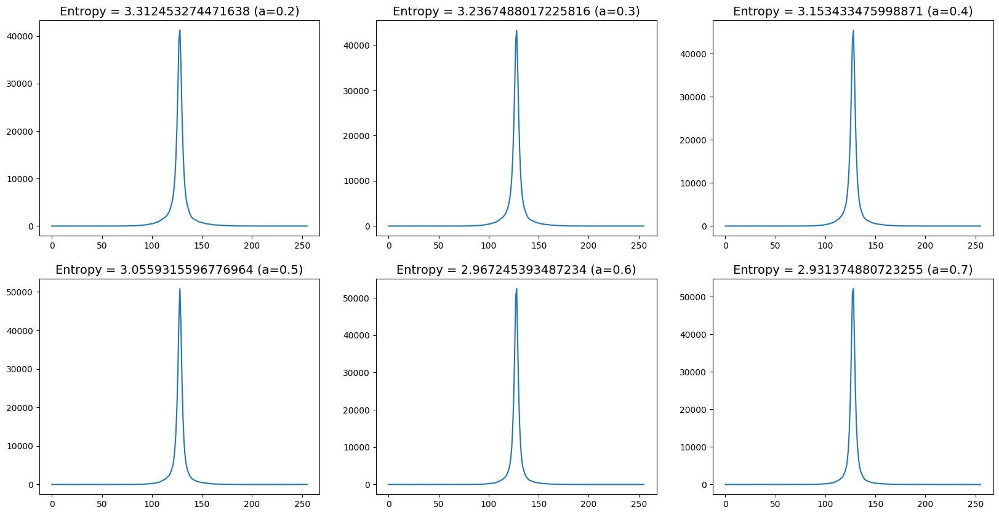

In [113]:
[entropy_lena_grey,variance_lena_grey]=ShowHistogramsFora(Lena_gray,5) 

έγχρωμη εικόνα Lena:

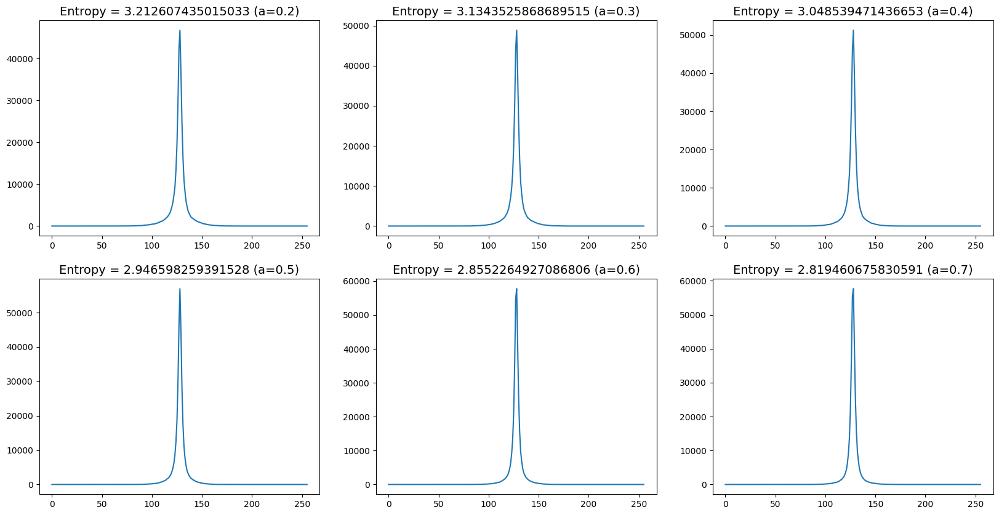

In [114]:
[entropy_lena_rgb,variance_lena_rgb]=ShowHistogramsFora(Lena_RGB,5) 

εικόνα Camera:

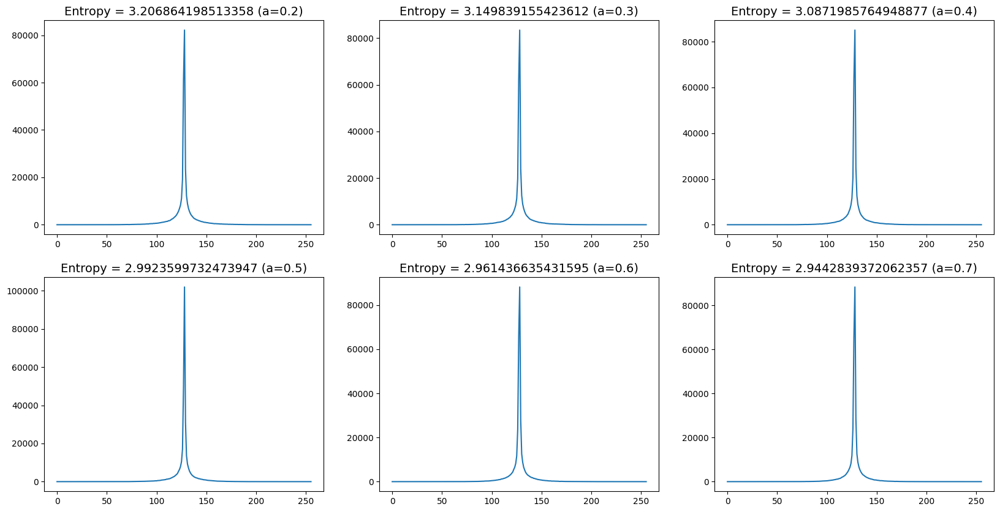

In [115]:
[entropy_camera,variance_camera]=ShowHistogramsFora(Camera,5) 

Παρατηρούμε ότι η εντροπία μειώνεται συνεχώς για αύξηση του α. Υλοποιήσαμε την παρακάτω συνάρτηση για να δούμε πού παρουσιάζουν ελάχιστο η εντροπία και η διακύμανση:

In [116]:
#A function to compute entropy and variance plots for a specific depth
def computeEntropyVariance (Image,depth,title):
    final_sum_hist=[]
    probs = [0.2,0.25, 0.3, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1]        #array that keeps values of x axis
    entropy=[]
    variance=[]
    tmp=0
    for i in range (0,17):
        tmp=probs[i]
        helper=calcHist(Image,tmp,depth)                                                                      #compute histogram for each depth value
        a=np.max(helper)                                                                                      #calculate max value of histogram
        final_sum_hist.append(helper/a)
        entropy.append(st.entropy(helper/a)[0])                                                               #calculate entropy of normalised histogram
        variance.append(np.var(helper/a))                                                                     #calculate variance of normalised histogram
    f, ax = plt.subplots(1, 2, figsize=(15, 4) ) 
    plt.subplot(1,2,1)
    plt.plot(probs, entropy, marker='.')                                                                      #plot entropy
    plt.title('Entropy of '+str(title)+' image')
    plt.xlabel('a')
    plt.ylabel('Entropy')
    plt.subplot(1,2,2)
    plt.plot(probs, variance, marker='.')                                                                     #plot variance
    plt.title('Variance of '+str(title)+' image')
    plt.xlabel('a')
    plt.ylabel('Variance')
    plt.show()
    return entropy,variance

ασπρόμαυρη εικόνα Lena:

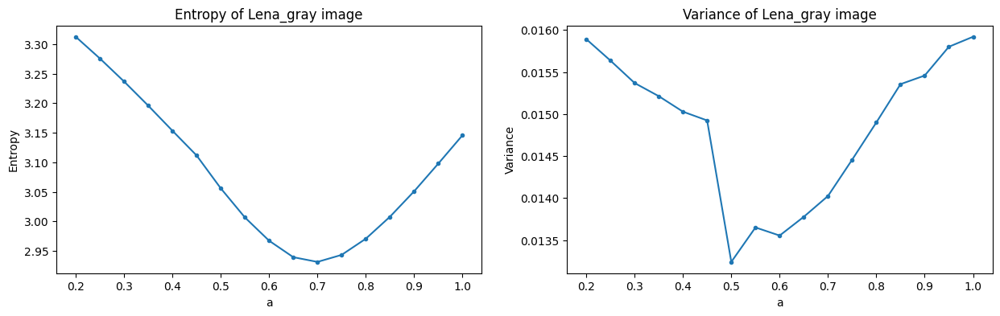

In [117]:
[entropy_lena_grey,variance_lena_grey]=computeEntropyVariance(Lena_gray,5,"Lena_gray")

έγχρωμη εικόνα Lena:

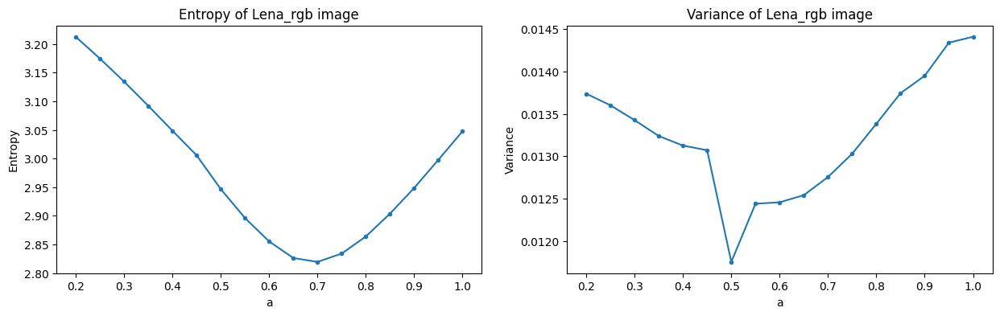

In [118]:
[entropy_lena_rgb,variance_lena_rgb]=computeEntropyVariance(Lena_RGB,5,"Lena_rgb")

εικόνα Camera:

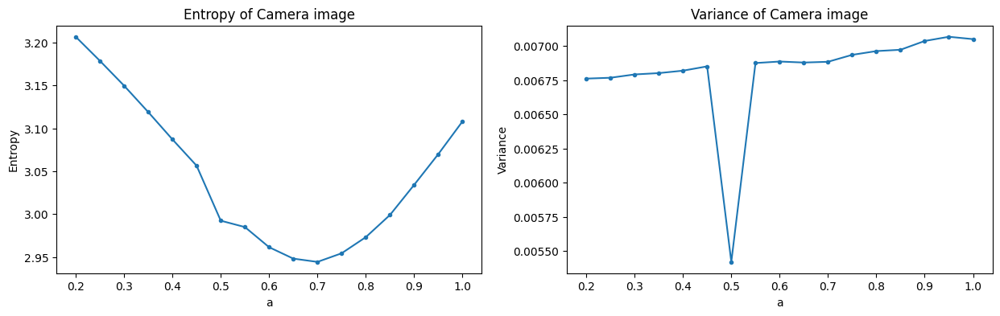

In [119]:
[entropy_camera,variance_camera]=computeEntropyVariance(Camera,5,"Camera")

Η εντροπία παρουσιάζει τοπικό ελάχιστο το οποίο μεταβάλλεται ανάλογα με την εικόνα παραμένοντας ωστόσο σε χαμηλό επίπεδο (χαμηλότερο του επιπέδου της εντροπίας της αρχικής εικόνας), όπως ήταν αναμενόμενο δεδομένης της αποσυσχέτισης των pixel των εικόνων της Λαπλασιανής πυραμίδας. Ακόμα, παρατηρούμε ότι σε κάθε περίπτωση το τοπικό ελάχιστο εμφανίζεται στο διάστημα [0.6,0.7] για την παράμετρο α, κάτι το οποίο βρίσκεται σε συμφωνία με την θεωρητική ανάλυση του paper της εκφώνησης.

Αντίθετα, παρατηρούμε ότι το variance δεν ακολουθεί σταθερή κατανομή και παρουσιάζει ελάχιστο για α = 0.5 και άρα συμπεραίνουμε ότι για τιμές του α στο διάστημα [0.5,0.7] μπορούμε να πετύχουμε μια αρκετά χαμηλή τιμή τόσο στην εντροπία όσο και στην διακύμανση κάτι το οποίο μας επιτρέπει να έχουμε τον ελάχιστο αριθμό από bits ανά pixel που χρειάζονται για την κωδικοποίηση της εκάστοτε εικόνας.

Για μεταβλητό depth έχουμε:

Για την ασπρόμαυρη εικόνα Lena:



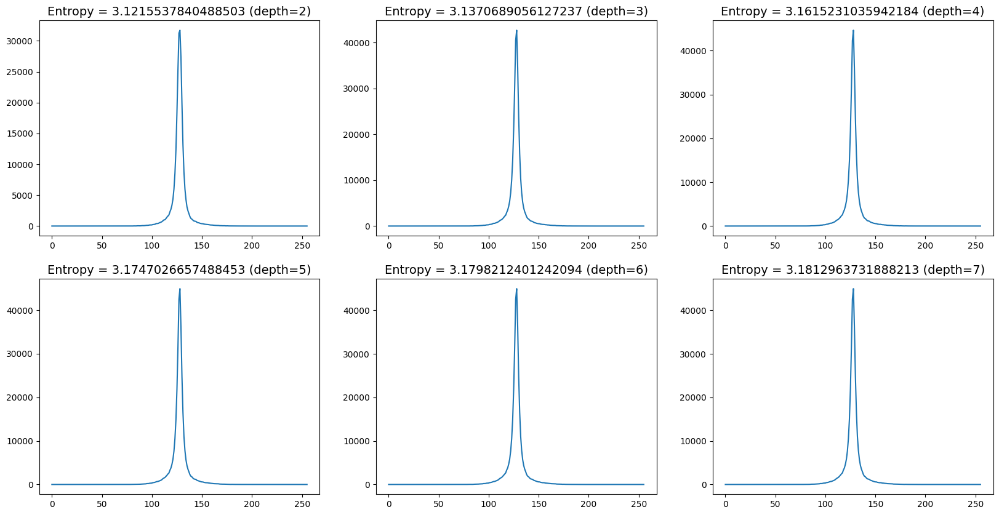

In [120]:
entropy_lena_gray=ShowHistogramsFordepth(Lena_gray,3/8)

Για την έγχρωμη εικόνα Lena:


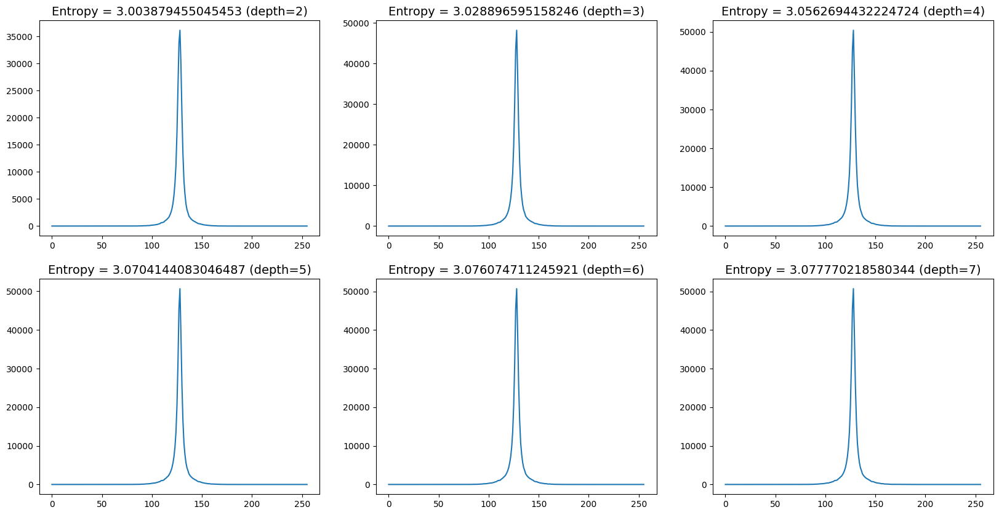

In [121]:
entropy_lena_rgb=ShowHistogramsFordepth(Lena_RGB,3/8)

Για την εικόνα Camera:

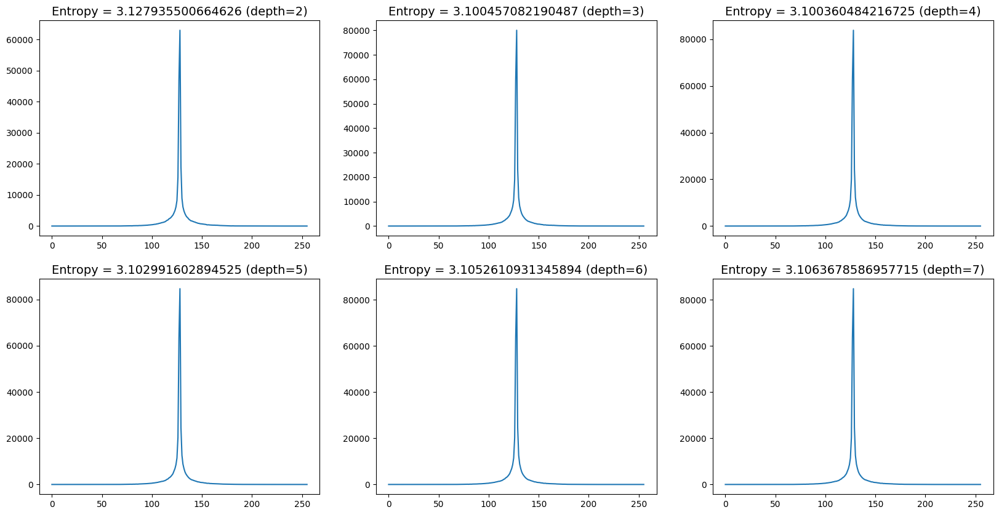

In [122]:
entropy_camera=ShowHistogramsFordepth(Camera,3/8)

In [123]:
#Compute entropy plot for a specific a
def computeEntropyVarianceDepth (Image,a,title):
    entropy=[]
    probs=np.arange(2,8,1)                                                                    #an array that stores the values for x axis
    for i in range (2,8):
        helper=calcHist(Image,a,i)                                                            #compute histogram for a specific depth
        b=np.max(helper)                                                                      #caclulate max value of histogram
        entropy.append(st.entropy(helper/b)[0])                                               #compute entropy of normalised histogram
    plt.plot(probs, entropy, marker='.')                                                      #plot entropy
    plt.title('Entropy of '+str(title)+' image')
    plt.xlabel('depth')
    plt.ylabel('Entropy')
    return entropy

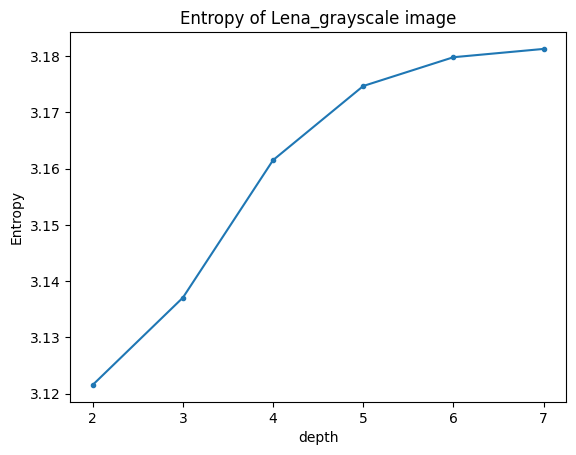

In [124]:
entropy_lena_grey=computeEntropyVarianceDepth(Lena_gray,3/8,"Lena_grayscale")

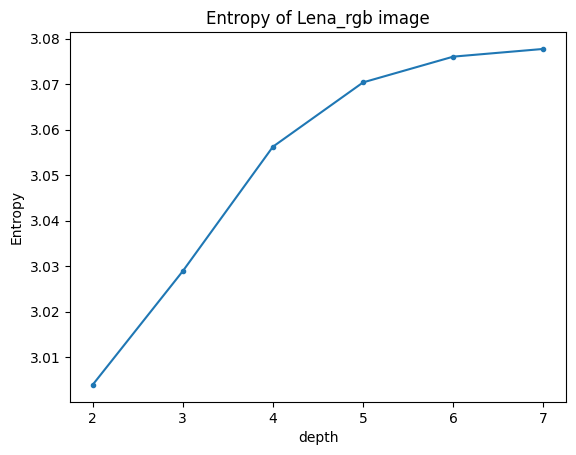

In [125]:
entropy_lena_rgb=computeEntropyVarianceDepth(Lena_RGB,3/8,"Lena_rgb")

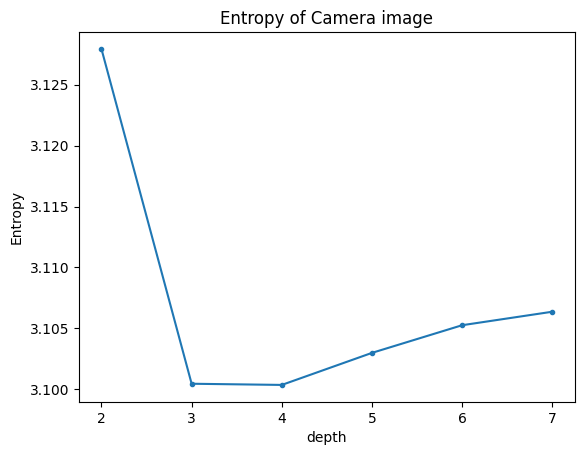

In [126]:
entropy_camera=computeEntropyVarianceDepth(Camera,3/8,"Camera")

Παρατηρούμε ότι η παράμετρος depth δεν επηρεάζει σε μεγάλο βαθμό την εντροπία καθώς βλέπουμε ότι υπάρχει μία μικρή μόνο αύξηση της, της τάξης δεκαδικών ψηφίων, κάτι το οποίο μας οδηγεί στο συμπέρασμα ότι η παράμετρος depth δεν αποτελεί βασικό κριτήριο για την ελαχιστοποίηση της εντροπίας.

**Ερώτημα ε):**

Στο ερώτημα αυτό μας ζητήθηκε να βρούμε το βέλτιστο α ελαχιστοποιώντας ταυτόχρονα την εντροπία και την διακύμανση των τιμών ανά επίπεδο. Mεταβάλλουμε το α κρατώντας σταθερό το depth μιας και όπως προαναφέρθηκε, η παράμετρος depth επηρεάζει σε πολύ μικρό βαθμό την εντροπία καθιστώντας το α την καθοριστική παράμετρο για την ελαχιστοποίηση αυτής.

Σύμφωνα με την θεωρητική ανάλυση του paper γνωρίζουμε ότι για τη ελαχιστοποιήση της συσχέτισης μεταξύ των pixels ευθύνεται η εντροπία και η διακύμανση, επομένως σκοπός μας ήταν η εύρεση του α τέτοιου ώστε να υπάρχει ελαχιστοποίηση τόσο της εντροπίας όσο και της διακύμανσης σε όσο το δυνατόν περισσότερα επίπεδα της πυραμίδας. Έτσι, υπολογίσαμε το ιστόγραμμα ανά επίπεδο κάθε πυραμίδας και με αυτό μπορέσαμε να βρούμε την εντροπία και την διακύμανση του κάθε επιπέδου.

Επιπλέον για την παράμετρο depth χρησιμοποιήσαμε την τιμή 5 καθώς όπως αναφέραμε η παράμετρος αυτή δεν επηρεάζει σημαντικά την εντροπία.


In [127]:
#Compute histogram for a specific pyramid level
def computeSumHistByLevel(LaplacianPyramid,depth,i):  
    hist = cv2.calcHist(np.float32([LaplacianPyramid[i]]), [0], None, [256], [0, 256])                        #compute histogram for pyramid level i
    return hist/hist.max()

#Compute pyramid and histogram for a specific a, depth and level i
def calcHistByLevel (Image,a,depth,i): 
    LaplacianPyramid=LPyramid(Image,a,depth)                                                                  #compute Laplacian pyramid
    sum_hist = computeSumHistByLevel(LaplacianPyramid,depth,i)                                                #compute histogram
    return sum_hist

#Plot entropy and variance for every level of the pyramid, for a in range [0.2,1]
def computeEntropyVarianceByLevel (Image,depth,title):
    final_sum_hist=[]
    probs = [0.2,0.25, 0.3, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1]        #an array that holds the values for x axis
    tmp=0
    for j in range (0,5):                                                                                     #for each level
        entropy=[]
        variance=[]
        for i in range (0,17):                                                                                #for each a
            tmp=probs[i]
            helper=calcHistByLevel(Image,tmp,depth,j)                                                         #compute histogram
            a=np.max(helper)                                                                                  #calculate max value
            final_sum_hist.append(helper/a)                                                             
            entropy.append(st.entropy(helper/a)[0])                                                           #compute entropy of the normalised histogram
            variance.append(np.var(helper/a))                                                                 #compute variance of the normalised histogram
        f, ax = plt.subplots(1, 2, figsize=(15, 4) ) 
        plt.subplot(1,2,1)
        plt.plot(probs, entropy, marker='.')                                                                  #plot the entropy of each level
        plt.title('Entropy of '+str(title)+' image, level '+str(j))
        plt.xlabel('a')
        plt.ylabel('Entropy')
        plt.subplot(1,2,2)
        plt.plot(probs, variance, marker='.')                                                                 #plot the variance of each level
        plt.title('Variance of '+str(title)+' image, level '+str(j))
        plt.xlabel('a')
        plt.ylabel('Variance')
        plt.show()
    return entropy,variance

Παρακάτω παρουσιάζονται τα διαγράμματα της εντροπίας και της διακύμανσης για διαφορετικές τιμές της παραμέτρου α για κάθε επίπεδο της προκύπτουσας Λαπλασιανής πυραμίδας προκειμένου να είναι δυνατή η οπτική σύγκριση των ελαχίστων τιμών.

Για την εικόνα Lena grayscale:

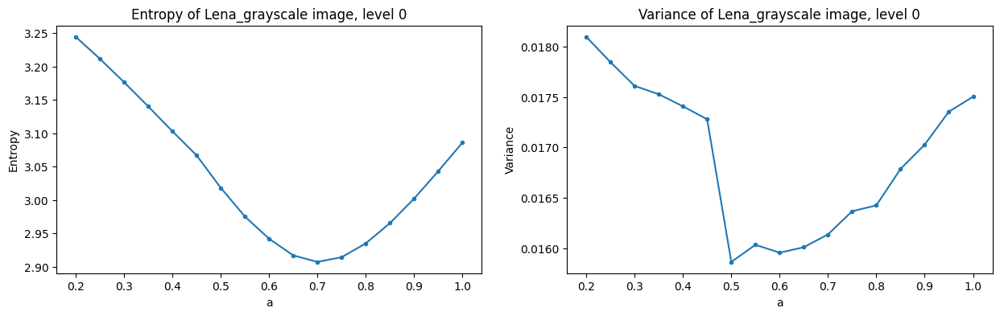

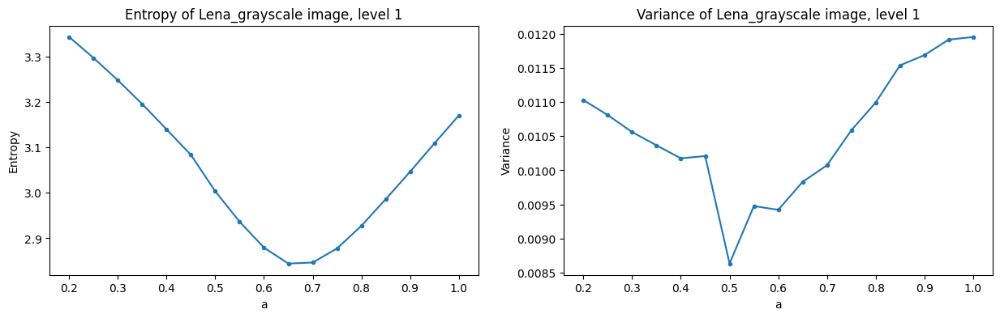

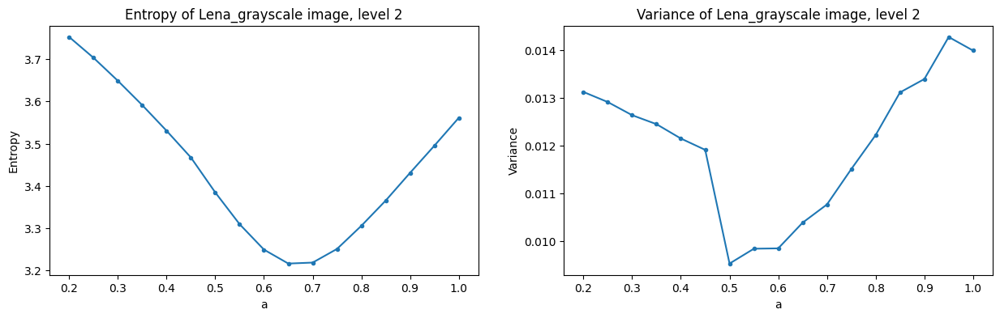

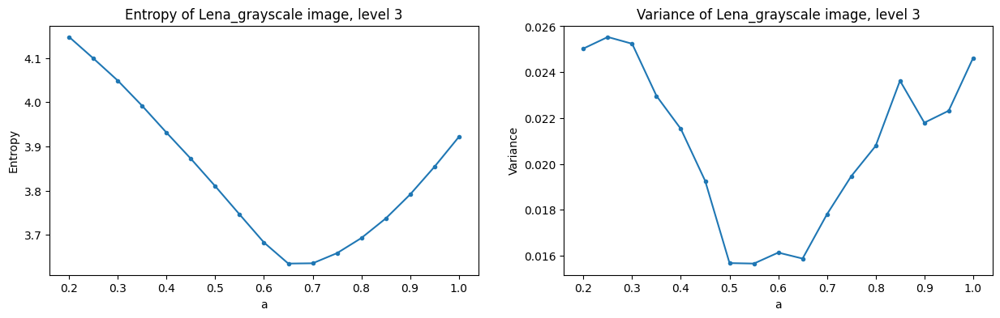

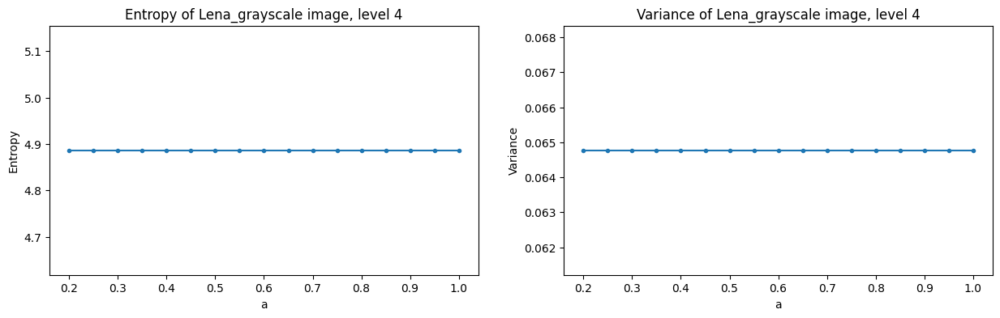

In [128]:
[entropy_lena_grey,variance_lena_grey]=computeEntropyVarianceByLevel(Lena_gray,5,"Lena_grayscale")

 Lena RGB:

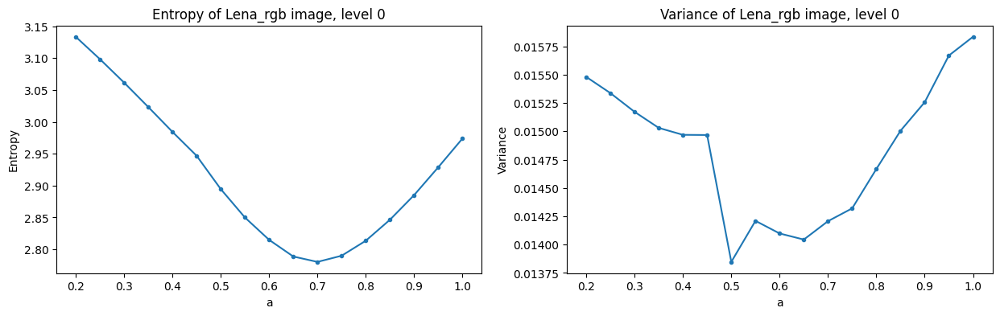

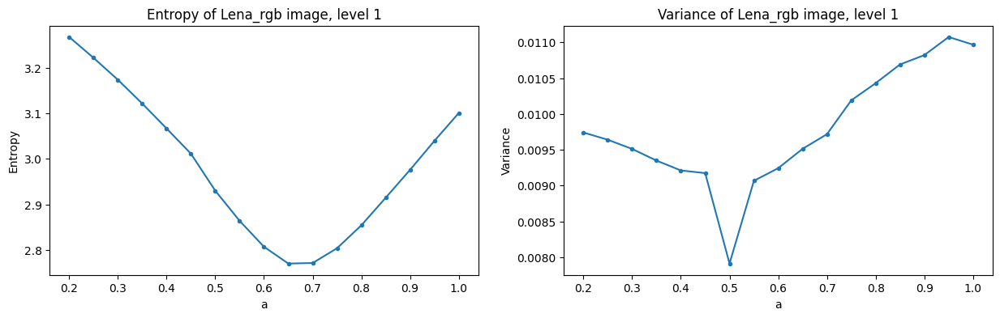

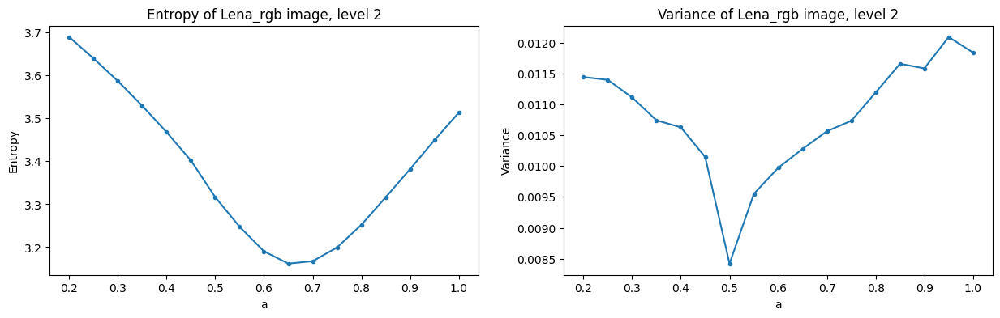

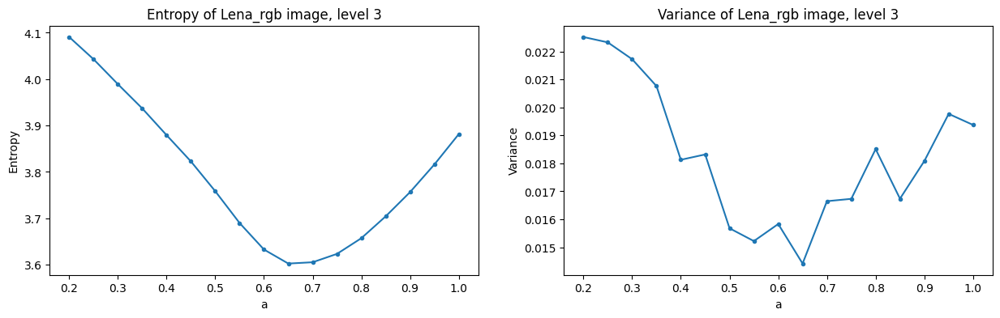

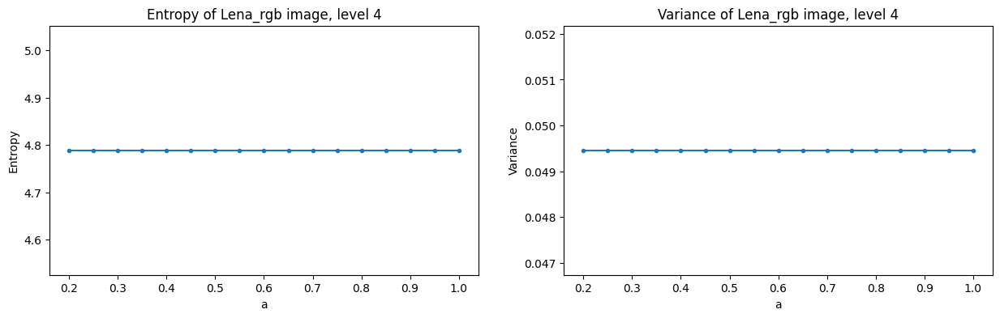

In [129]:
[entropy_lena_rgb,variance_lena_rgb]=computeEntropyVarianceByLevel(Lena_RGB,5,"Lena_rgb")

Camera:

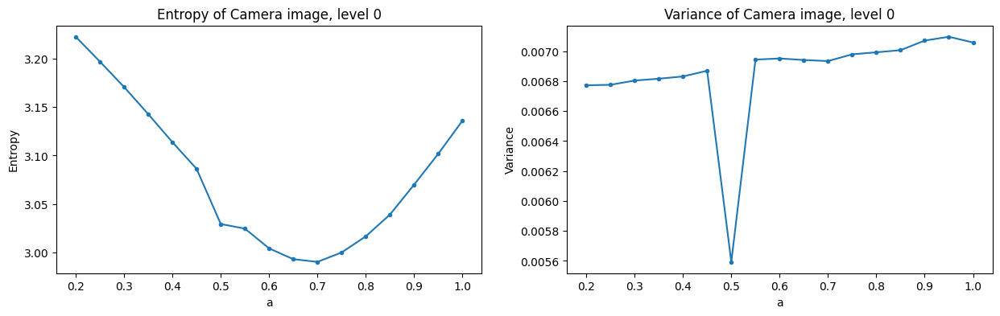

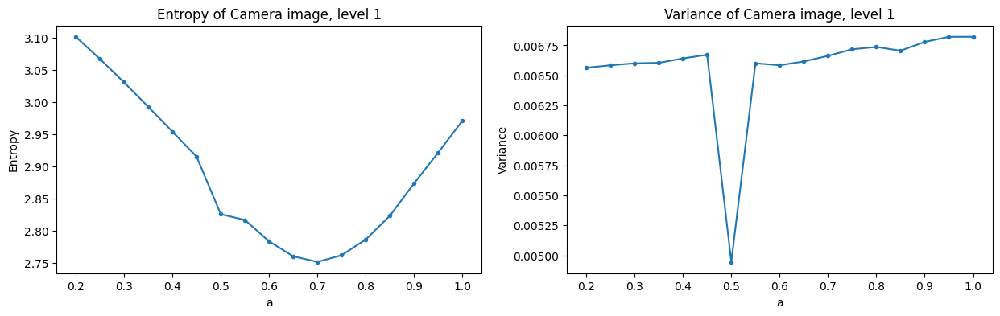

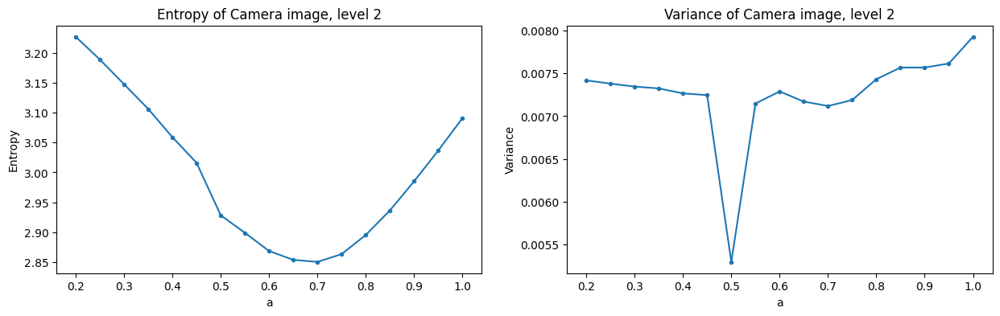

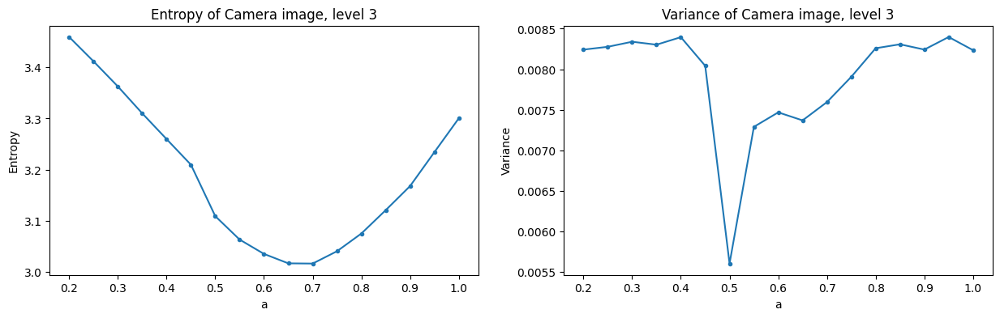

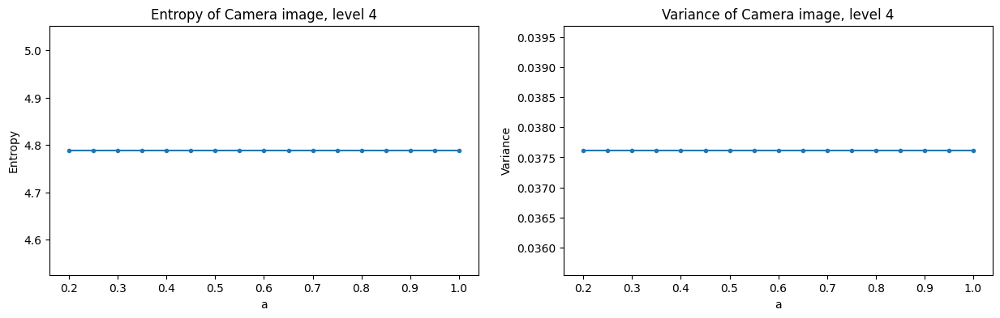

In [130]:
[entropy_camera,variance_camera]=computeEntropyVarianceByLevel(Camera,5,"Camera")

Παρατηρούμε ότι η εντροπία ανά επίπεδο έχει αντίστοιχη κατανομή (εκτός του τελευαίου επιπεδου) και παρουσιάζει ελάχιστο στο διάστημα [0.6-0.7] όπως και ήταν αναμενόμενο. Η διακύμανση από την άλλη παρουσιάζει διαφοροποιήσεις στην κατανομή από επίπεδο σε επίπεδο ωστοσο στις περισσότερες περιπτώσεις το ελάχιστο βρίσκεται για α = 0.5.

Καθώς γύρω από το τοπικό ελάχιστο έχουμε ομαλή αύξηση/μείωση τόσο της εντροπίας όσο και της διακύμανσης, εκτιμούμε ότι ο υπολογισμός ενός μέσου όρου των τιμών του α που ελαχιστοποιουν την εντροπία και την διακύμανση σε κάθε επίπεδο, αποτελεί ένα ικανό κριτήριο για την επίτευξη τόσο χαμηλής εντροπίας όσο και διακύμανσης στο σύνολο της πυραμίδας.

In [131]:
#A function to compute histogram for a specific pyramid level
def computeHistDepthLevel(LaplacianPyramid,level):  
    histByLevel = []
    hist = cv2.calcHist(np.float32([LaplacianPyramid[level]]), [0], None, [256], [0, 256])        #compute histogram for a specific level
    return hist

#A function to compute Laplacian pyramid and histogram for a specific level
def calcHistLevel (Image,a,depth,level):    
    LaplacianPyramid=LPyramid(Image,a,depth)                                                      #compute Laplacian pyramid
    hist_by_level = computeHistDepthLevel(LaplacianPyramid,level)                                 #compute histogram for a specific level
    return hist_by_level

#A function to compute best a
def HistogramsLevel(Image,depth):  
    entropyarr=[]
    variancearr=[]
    for j in range (depth):                                                                       #for each level of the pyramid
      min_entropy = 100
      min_variance = 100
      for i in range (2,8):                                                                       #for each a
            i=i/10
            histbylevel=calcHistLevel(Image,i,depth,j)                                            #compute histogram for level j 
            entropy=(st.entropy(histbylevel/histbylevel.max())[0])                                #compute entropy of normalised histogram for level j
            variance=np.var(histbylevel/histbylevel.max())                                        #compute variance of normalised histogram for level j
            if (entropy < min_entropy):                                                           #we keep the minimum entropy
              entropymin=i
              min_entropy=entropy
            if (variance < min_variance):                                                         #we keep the minimum variance
              variancemin=i
              min_variance=variance  
      entropyarr.append(entropymin)                                                         
      variancearr.append(variancemin)
    a=(np.mean(entropyarr)+np.mean(variancearr))/2                                                #best a is computed by a = (mean(minimum entropy)+mean(minimum variance))/2
    return a

Lena grayscale:

In [132]:
min_a_lena_gray=HistogramsLevel(Lena_gray,5)
print("Best a for Lena grayscale : "+str(min_a_lena_gray))

Best a for Lena grayscale : 0.52


Για την έγχρωμη εικόνα Lena RGB:

In [133]:
min_a_lena_rgb=HistogramsLevel(Lena_RGB,5)
print("Best a for Lena RGB : "+str(min_a_lena_rgb))

Best a for Lena RGB : 0.52


 Camera:

In [134]:
min_a_camera=HistogramsLevel(Camera,5)
print("Best a for camera : "+str(min_a_camera))

Best a for camera : 0.52


Όπως ειναι λογικό, επειδή οι φωτογραφίες είναι διαφορετικές έχουν διαφορετικό βέλτιστο α το οποίο πράγματι ανήκει σο διάστημα [0.5-0.7] όπως αναμέναμε με βάση τα διαγράμματα.

**Ερώτημα στ):**

Σε αυτό το ερώτημα υλοποιήσαμε τρεις υποσυναρτήσεις κβαντισμού για δύο διαφορετικά πειράματα. Με βάση το paper γνωρίζουμε ότι σε μεγαλύτερα επίπεδα στην πυραμίδα θα πρέπει να έχουμε μικρότερο bin size, καθώς η ευαισθησία του ανθρώπου σε σφάλματα στην πληροφορία που κωδικοποιείται σε αυτά είναι μεγαλύτερη.

Σύμφωνα με το δοσμένο άρθρο προτεινόμενη μέθοδος για την επιλογή του μεγέθους bin για κάθε επίπεδο για την κβάντιση είναι η τιμή εκείνη για την οποία μόλις αρχίζει να φαίνεται η υποβάθμιση της ποιότητας σε σχέση με την μη κβαντισμένη εικόνα γι αυτό το επίπεδο, για απόσταση παρατηρητή ίση με πέντε φορές το πλάτος της εικόνας. Επιλέγουμε την εκτέλεση τριών πειραμάτων, προκειμένου να εξετάσουμε την παραπάνω προτεινόμενη μέθοδο: Στο πρώτο πείραμα επιλέγουμε bin size για κάθε επίπεδο ώστε να είναι μόλις εμφανής η οπτική υποβάθμιση σε κάθε επίπεδο. Στο δεύτερο πείραμα επιλέγουμε bin size ώστε να είναι πιο έντονη η οπτική υποβάθμιση ανά επίπεδο αλλά να έχουμε λιγότερα επίπεδα κβάντισης και άρα λιγότερα απαιτούμενα bits ανά pixel.

In [135]:
#Compute quantized pyramid for the first experiment
def firstExp(pyramid):
    quantized_lap=[]
    bin_sizes=len(pyramid) 
    bins=[14,23,40,45,48]                                                                #bin sizes for the first experiment
    for i in range (0, bin_sizes):    
        image_quantized=L_Quantization(pyramid[i],bins[i])                               #compute quantized pyramid
        quantized_lap.append(image_quantized)  
    return quantized_lap

In [136]:
#Compute quantized pyramid for the second experiment
def secondExp(pyramid):
    quantized_lap=[]
    bin_sizes=len(pyramid)  
    bins=[8,14,22,26,27]                                                                 #bin sizes for the second experiment
    for i in range (0, bin_sizes):    
        image_quantized=L_Quantization(pyramid[i],bins[i])                               #compute quantized pyramid
        quantized_lap.append(image_quantized)  
    return quantized_lap

In [137]:
#Compute quantized pyramid for the third experiment
def thirdExp(pyramid):
    quantized_lap=[]
    bin_sizes=len(pyramid) 
    bins=[25,40,58,64,65]                                                                #bin sizes for the third experiment
    for i in range (0, bin_sizes):    
        image_quantized=L_Quantization(pyramid[i],bins[i])                               #compute quantized pyramid
        quantized_lap.append(image_quantized)  
    return quantized_lap

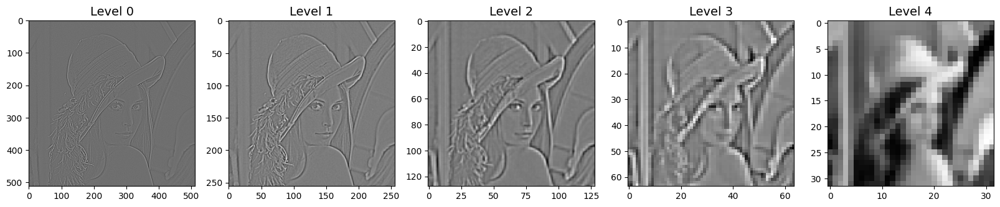

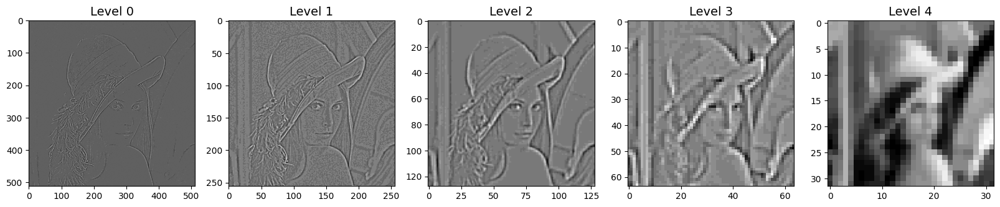

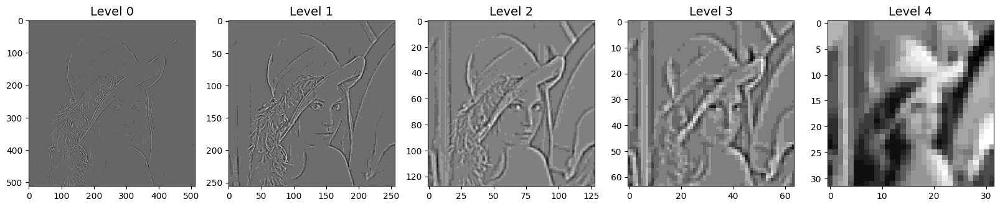

In [138]:
#orginal pyramid
Lena_gray_lap=LPyramid(Lena_gray,0.52,5)
showPyramid(Lena_gray_lap, 'gray')

#first experiement
Lena_gray_lap_quant_first=firstExp(Lena_gray_lap)
showPyramid(Lena_gray_lap_quant_first, 'gray')

#second experiement
Lena_gray_lap_quant_second=secondExp(Lena_gray_lap)
showPyramid(Lena_gray_lap_quant_second, 'gray')


Δείχνουμε την αρχική εικόνα μαζί με κάθε reconstructed εικόνα που προέκυψε μετά απο αποκωδικοποίηση των παραπάνω εικόνων προκειμένου να υπάρχει οπτική σύγκριση:

In [142]:
#A function to show reconstructed image next to the original image
def showExperimentsDecoded(original,quant_f,quant_s,a,type):
    quantized=[quant_f,quant_s]                                                         #takes as input the quantized image of the three experiments
    exp=["first","second"]
    Decoded=[]
    for i in range (2):
        Decoded.append(L_Pyramid_Decode(quantized[i],a))                                        #decode each quantized image
        f1, (ax0,ax1)= plt.subplots(1, 2, figsize=(10, 10))
        if (type=="gray"):                                                                      #if image is grayscale
            ax0.imshow(Decoded[i], cmap="gray")                                                 #plot reconstructed image
            ax0.set_title('Reconstructed from '+str(exp[i])+" experiment", fontsize=10)
            ax1.imshow(original, cmap="gray")                                                   #plot original image
            ax1.set_title('Original', fontsize=10)
        else:                                                                                   #if image is RGB
            ax0.imshow(Decoded[i].astype(int))                                                  #plot reconstructed image
            ax0.set_title('Reconstructed', fontsize=14)
            ax1.imshow(original)                                                                #plot original image
            ax1.set_title('Original', fontsize=14)
    return Decoded

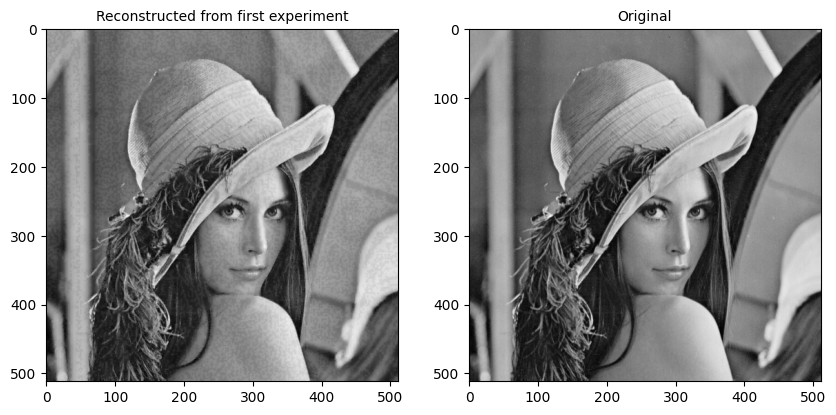

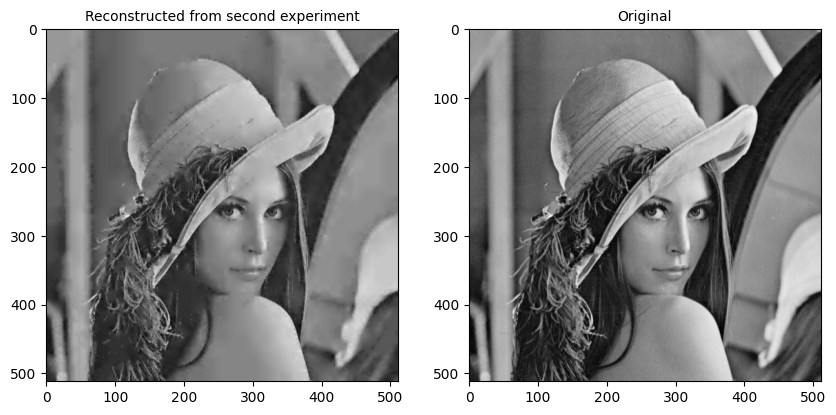

In [143]:
Lena_gray_decoded=showExperimentsDecoded(Lena_gray,Lena_gray_lap_quant_first,Lena_gray_lap_quant_second,0.52,'gray')

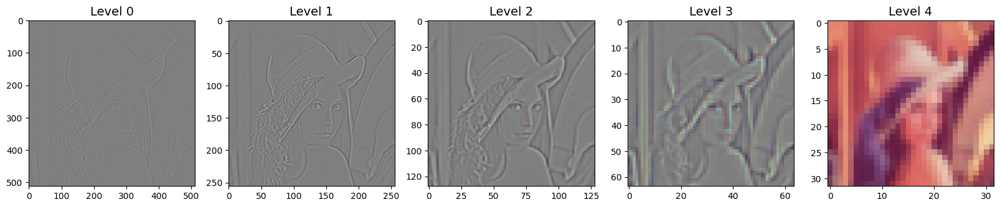

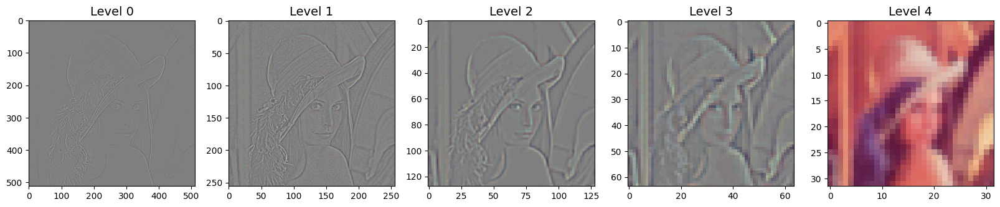

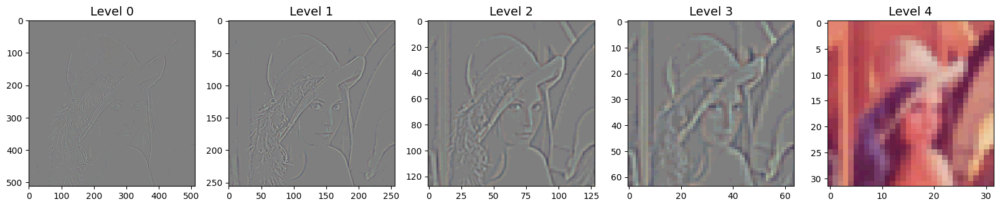

In [144]:
Lena_rgb_lap=LPyramid(Lena_RGB,0.53,5)
showPyramid(Lena_rgb_lap, 'RGB')

Lena_rgb_lap_quant_first=firstExp(Lena_rgb_lap)
showPyramid(Lena_rgb_lap_quant_first, 'RGB')

Lena_rgb_lap_quant_second=secondExp(Lena_rgb_lap)
showPyramid(Lena_rgb_lap_quant_second, 'RGB')

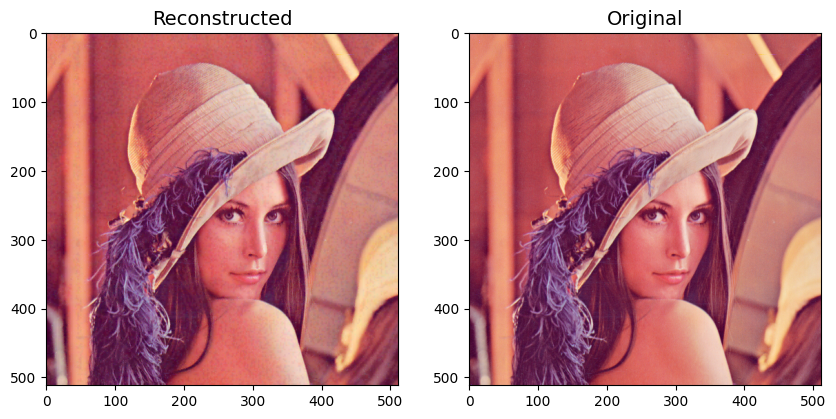

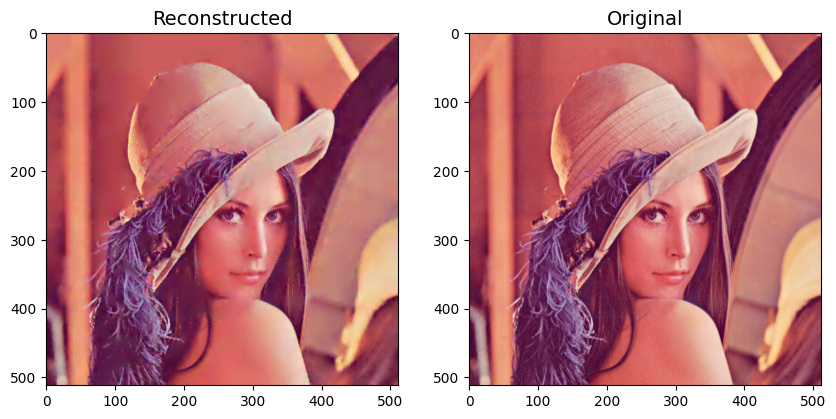

In [150]:
Lena_rgb_decoded=showExperimentsDecoded(Lena_RGB,Lena_rgb_lap_quant_first,Lena_rgb_lap_quant_second,0.53,'rgb')

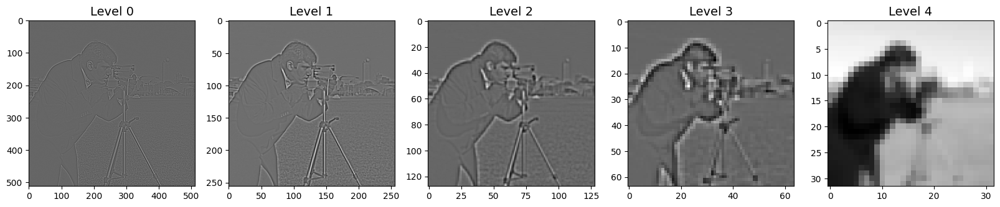

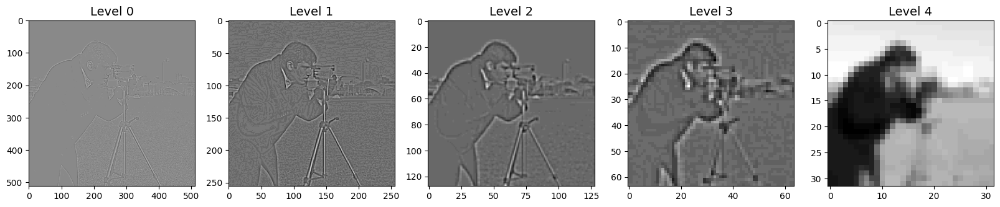

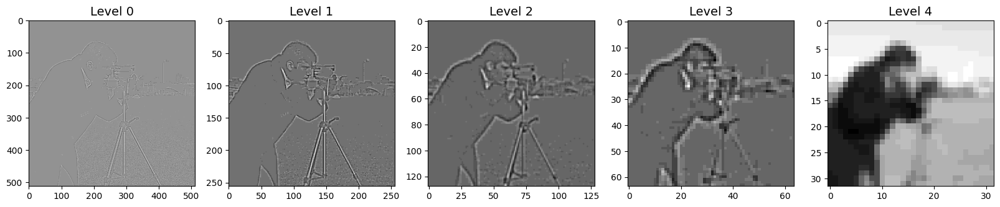

In [146]:
Camera_gray_lap=LPyramid(Camera,0.52,5)
showPyramid(Camera_gray_lap, 'gray')

Camera_gray_lap_quant_first=firstExp(Camera_gray_lap)
showPyramid(Camera_gray_lap_quant_first, 'gray')

Camera_gray_lap_quant_second=secondExp(Camera_gray_lap)
showPyramid(Camera_gray_lap_quant_second, 'gray')

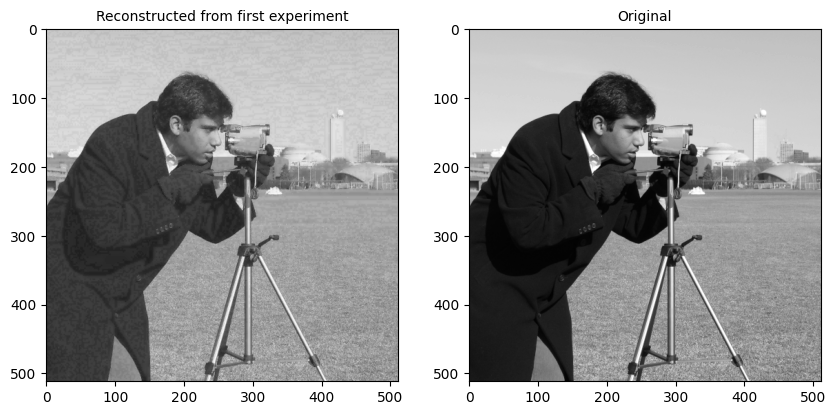

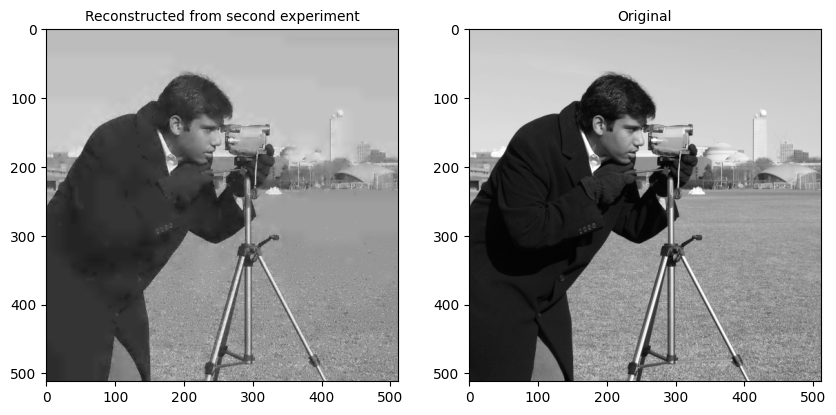

In [148]:
Camera_decoded=showExperimentsDecoded(Camera,Camera_gray_lap_quant_first,Camera_gray_lap_quant_second,0.52,'gray')

Αποτελέσματα παραπάνω πειραμάτων:

Το πρώτο πείραμα, όπου το bin size είναι τέτοιο σε κάθε επίπεδο ώστε να είναι μόλις διακριτή η οτική διαφοροποίηση, οδηγεί σε ανακατασκευασμένες εικόνες οι οποίες έχουν αρκετά καλή ποιότητα σε σχέση με την αρχική, με όλες τις λεπτομέρειες και τα χαρακτηρηστικά της εικόνας (π.χ. ακμές) να είναι εμφανή, ωστόσο παρατηρείται στην ανακατασευασμένη εκδοχή μία ήπιο υποβάθμιση στο χρώμα.
Στο δεύτερο πείραμα, όπου έχει επιλεγεί αρκετά μεγαλύτερο bin size σε κάθε επίπεδο, το οπτικό αποτέλεσμα της ανακατασευασκμένης εικόνας είναι υποδεέστερο, με την εικόνα να εμφανίζεται πιο θολή και ιδιαίτερα όσον αφορά τις ακμές της εικόνας, όπως άλλωστε ήταν αναμενόμενο λόγω της εντονότερης κβάντισης.
Επισημαίνουμε ότι, σε όλες τις περιπτώσεις, η ανακατασευασμένη εικόνα έχει αρκετά καλή ποιότητα, γεγονός που αποτελεί σημαντικό όφελος της μεθόδου της Λαπλασιανής πυραμίδας, καθώς μας επιτρέπεται η εντονότερη κβάντιση και άρα μείωση τoυ αριθμού bits ανά pixel, με παράλληλη διατήρηση της ποιότητας της εικόνας.